## 0. Setup

In [2]:
%matplotlib notebook

In [3]:
import numpy as np
import torch
import torchvision
import torchvision.transforms as T
import matplotlib.pyplot as plt
from EIANN import Network
import EIANN.utils as ut
import EIANN.plot as pt
import pprint

pt.update_plot_defaults()


# Load dataset
tensor_flatten = T.Compose([T.ToTensor(), T.Lambda(torch.flatten)])
MNIST_train_dataset = torchvision.datasets.MNIST(root='../optimize/data/mnist/datasets/MNIST_data/', train=True, download=False,
                                         transform=tensor_flatten)
MNIST_test_dataset = torchvision.datasets.MNIST(root='../optimize/data/mnist/datasets/MNIST_data/',
                                        train=False, download=False,
                                        transform=tensor_flatten)

# Add index to train & test data
MNIST_train = []
for idx,(data,target) in enumerate(MNIST_train_dataset):
    target = torch.eye(len(MNIST_train_dataset.classes))[target]
    MNIST_train.append((idx, data, target))
    
MNIST_test = []
for idx,(data,target) in enumerate(MNIST_test_dataset):
    target = torch.eye(len(MNIST_test_dataset.classes))[target]
    MNIST_test.append((idx, data, target))
    
# Put data in dataloader
data_generator = torch.Generator()
train_dataloader = torch.utils.data.DataLoader(MNIST_train[0:50000], shuffle=True, generator=data_generator)
val_dataloader = torch.utils.data.DataLoader(MNIST_train[-10000:], batch_size=10000, shuffle=False)
test_dataloader = torch.utils.data.DataLoader(MNIST_test, batch_size=10000, shuffle=False)

epochs = 1
data_seed = 257
network_seed = 66049

In [4]:
def plot_network_state(network, test_dataloader, title=None):
    
    pt.plot_batch_accuracy(network, test_dataloader, title=title)
    
    for layer in network:
        for population in layer:
            for projection in population:
                fig = plt.figure()
                plt.imshow(projection.weight.data, aspect='auto', interpolation='none')
                plt.suptitle('%s Weights: %s' % (title, projection.name))
                plt.colorbar()
                fig.show()

    for layer in network:
        for population in layer:
            fig = plt.figure()
            plt.imshow(torch.atleast_2d(population.activity.detach().T), aspect='auto', interpolation='none')
            plt.suptitle('%s Activity: %s' % (title, population.fullname))
            plt.colorbar()
            fig.show()

In [5]:
def train_mnist_network(network, train_dataloader, val_dataloader, train_steps, data_file_path=None, store_params=False):
    
    if data_file_path is not None:
        network.load(data_file_path)
    else:
        network.train(train_dataloader, val_dataloader, samples_per_epoch=train_steps, val_interval=(0, -1, 100), store_history=True, \
                      store_dynamics=True, store_params=store_params, status_bar=True)

In [6]:
def plot_mnist_network_accuracy(network, test_dataloader, supervised=True):
    if not supervised:
        _, sorted_output_idx = ut.sort_by_val_history(network)
    else:
        sorted_output_idx = torch.arange(0, network.val_output_history.shape[-1])
    pt.plot_batch_accuracy(network, test_dataloader, population='all', sorted_output_idx=sorted_output_idx, title='Final')
    pt.plot_train_loss_history(network)
    pt.plot_validate_loss_history(network)

In [7]:
def plot_mnist_network_intermediates(network):

    fig, axes = plt.subplots(4, 2, figsize=(10., 12.))
    try:
        im = axes[0][0].imshow(network.H1.E.plateau_history.T, aspect='auto', interpolation='none')
        plt.colorbar(im, ax=axes[0][0])
        axes[0][0].set_title('Plateau history: H1.E')
        axes[0][0].set_ylabel('Unit ID')
        axes[0][0].set_xlabel('Training steps')

        im = axes[0][1].imshow(network.Output.E.plateau_history.T, aspect='auto', interpolation='none')
        plt.colorbar(im, ax=axes[0][1])
        axes[0][1].set_title('Plateau history: Output.E')
        axes[0][1].set_xlabel('Training steps')

        binned_Output_E_plateau_prob = network.Output.E.plateau_history.T.reshape(network.Output.E.plateau_history.T.shape[0], -1, 100).mean(dim=(0,2))
        binned_H1_E_plateau_prob = network.H1.E.plateau_history.T.reshape(network.H1.E.plateau_history.T.shape[0], -1, 100).mean(dim=(0,2))
        binned_train_steps = torch.arange(1, len(binned_H1_E_plateau_prob) + 1) * 100

        axes[1][0].plot(binned_train_steps, binned_H1_E_plateau_prob)
        axes[1][1].plot(binned_train_steps, binned_Output_E_plateau_prob)
        axes[1][0].set_ylabel('Mean plateau amp')
        axes[1][0].set_xlabel('Training steps')
        axes[1][1].set_xlabel('Training steps')
        axes[1][0].set_title('Plateau_history: H1.E')
        axes[1][1].set_title('Plateau_history: Output.E')
    except: pass
    
    if isinstance(network.H1.E.forward_dendritic_state_history,  list):
        network.H1.E.forward_dendritic_state_history = torch.stack(network.H1.E.forward_dendritic_state_history)
    if isinstance(network.H1.E.backward_dendritic_state_history,  list):
        network.H1.E.backward_dendritic_state_history = torch.stack(network.H1.E.backward_dendritic_state_history)

    binned_H1_E_forward_dend_state = network.H1.E.forward_dendritic_state_history.T.reshape(network.H1.E.forward_dendritic_state_history.T.shape[0], -1, 100).mean(dim=(0,2))
    binned_H1_E_backward_dend_state = network.H1.E.backward_dendritic_state_history.T.reshape(network.H1.E.backward_dendritic_state_history.T.shape[0], -1, 100).mean(dim=(0,2))

    axes[2][0].plot(binned_train_steps, binned_H1_E_forward_dend_state)
    axes[2][0].set_title('Forward dendritic state: H1.E')
    axes[2][0].set_xlabel('Training steps')
    axes[2][0].set_ylabel('Mean amplitude')

    axes[2][1].plot(binned_train_steps, binned_H1_E_backward_dend_state)
    axes[2][1].set_title('Backward dendritic state: H1.E')
    axes[2][1].set_xlabel('Training steps')
    
    try:
        axes[3][0].plot(network.param_history_steps, torch.mean(network.H1.E.H1.DendI.weight_history, dim=(1,2)))
        axes[3][0].set_title('Weight history: H1.E.H1.DendI')
        axes[3][0].set_xlabel('Training steps')
        axes[3][0].set_ylabel('Mean weight')
    except: pass

    axes[3][1].plot(network.param_history_steps, torch.mean(network.H1.E.Output.E.weight_history, dim=(1,2)))
    axes[3][1].set_title('Weight history: H1.E.Output.E')
    axes[3][1].set_xlabel('Training steps')
    axes[3][1].set_ylabel('Mean weight')

    fig.tight_layout()
    fig.show()

In [8]:
def get_network(config_file_path, network_seed):
    network_config = ut.read_from_yaml(config_file_path)
    layer_config = network_config['layer_config']
    projection_config = network_config['projection_config']
    training_kwargs = network_config['training_kwargs']

    return Network(layer_config, projection_config, seed=network_seed, **training_kwargs)

## BP_like_1

Loading model data from '../optimize/data/mnist/20231109_EIANN_1_hidden_mnist_BP_like_config_1_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231109_EIANN_1_hidden_mnist_BP_like_config_1_66049_257_complete.pkl'
Batch accuracy = 90.91999816894531%


<IPython.core.display.Javascript object>


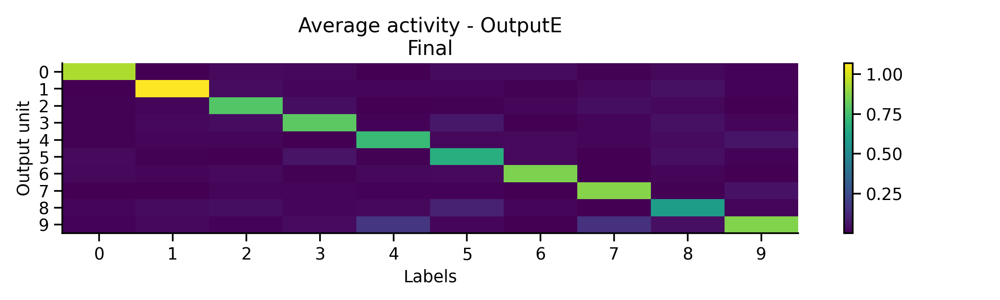

<IPython.core.display.Javascript object>


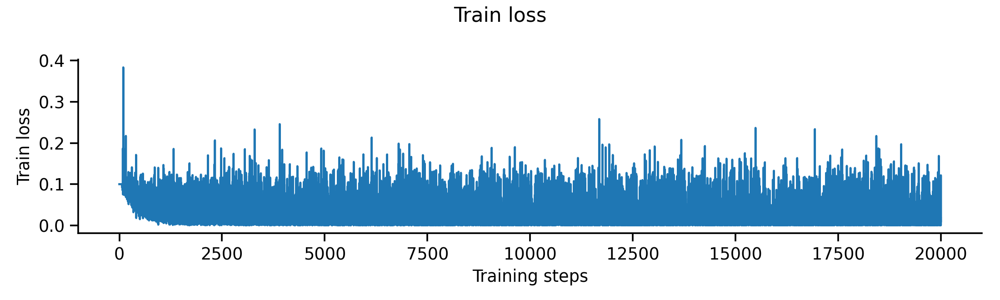

<IPython.core.display.Javascript object>


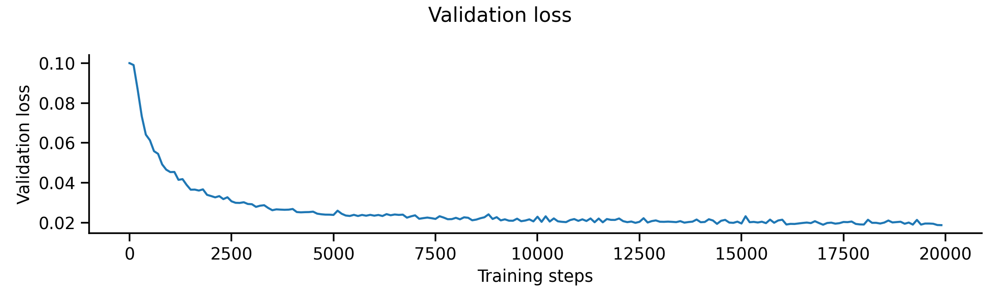

Batch accuracy = 90.91999816894531%


<IPython.core.display.Javascript object>


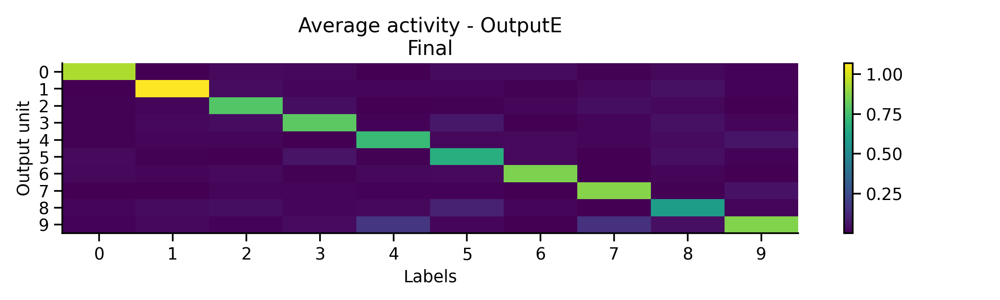

<IPython.core.display.Javascript object>


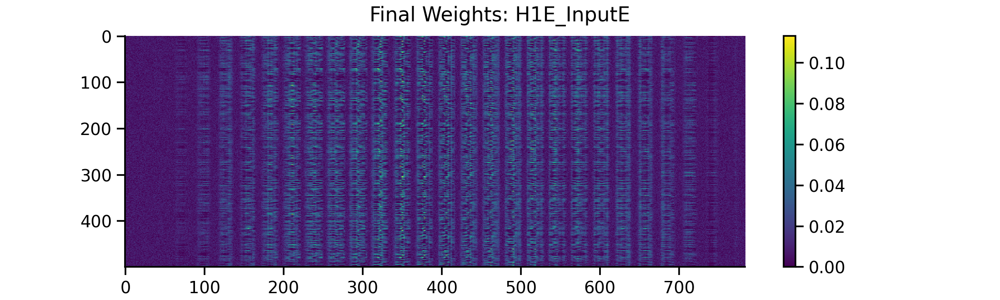

<IPython.core.display.Javascript object>


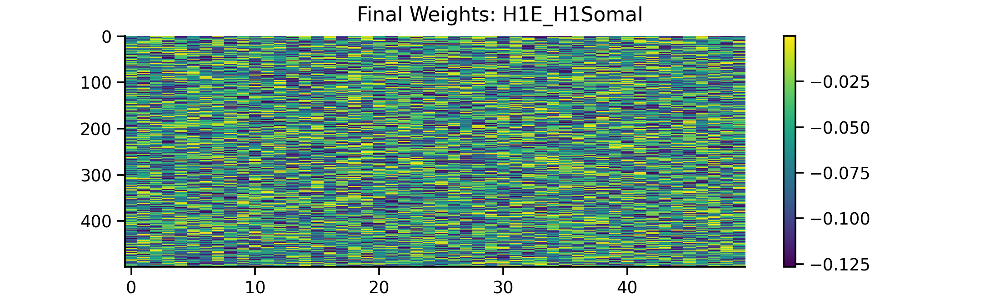

<IPython.core.display.Javascript object>


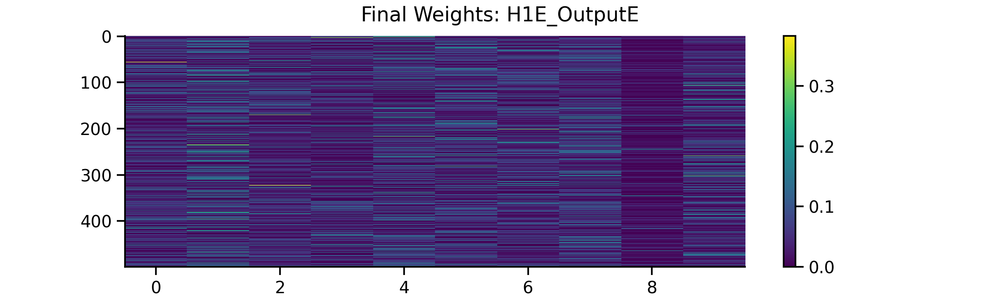

<IPython.core.display.Javascript object>


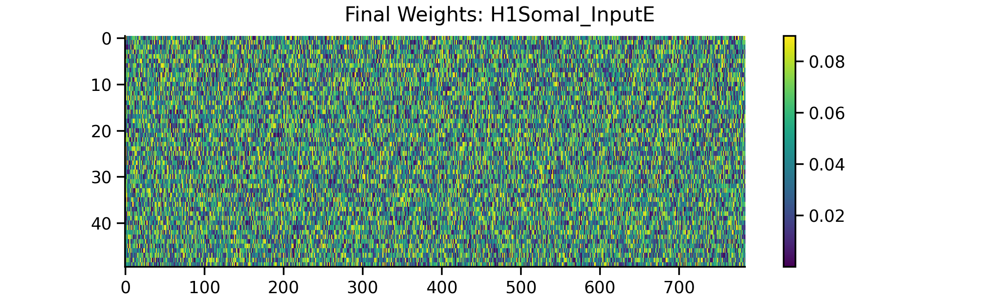

<IPython.core.display.Javascript object>


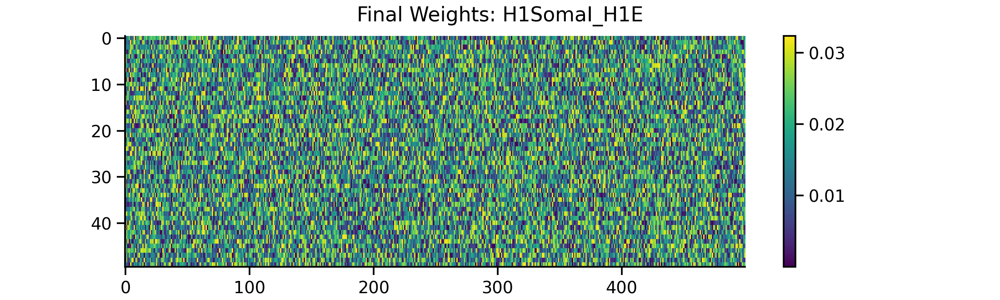

<IPython.core.display.Javascript object>


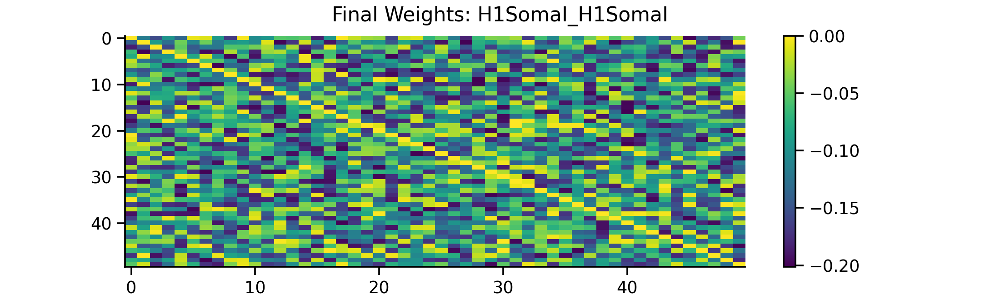

<IPython.core.display.Javascript object>


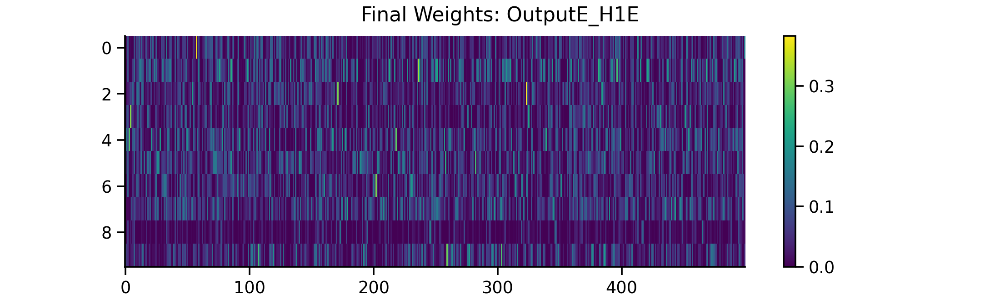

<IPython.core.display.Javascript object>


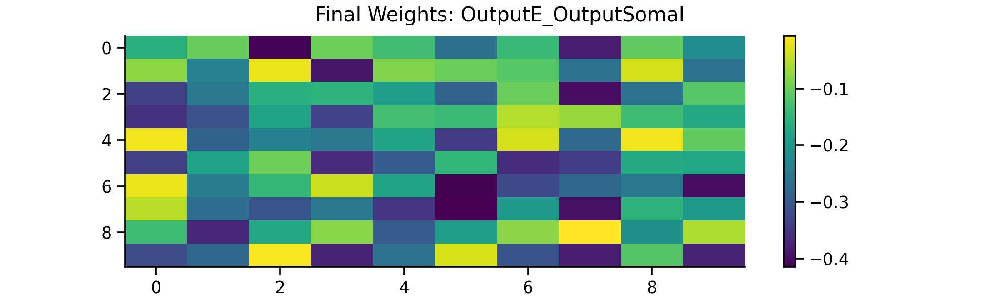

<IPython.core.display.Javascript object>


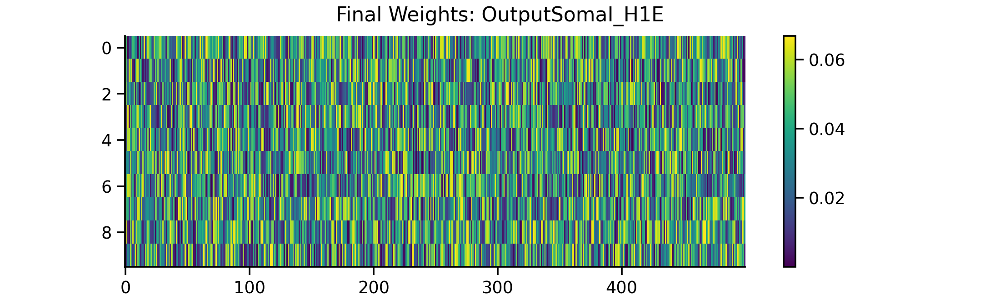

<IPython.core.display.Javascript object>


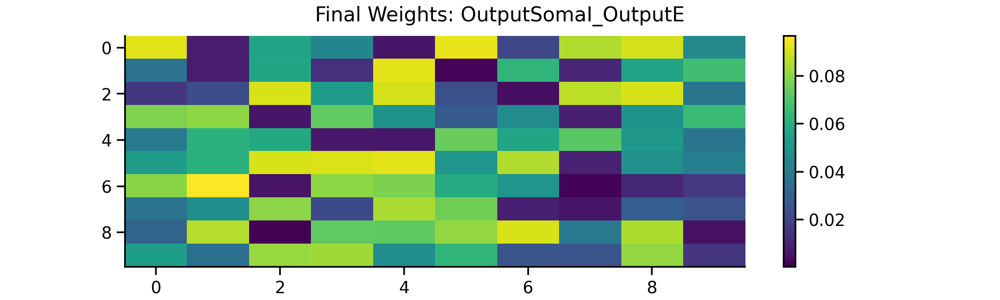

<IPython.core.display.Javascript object>


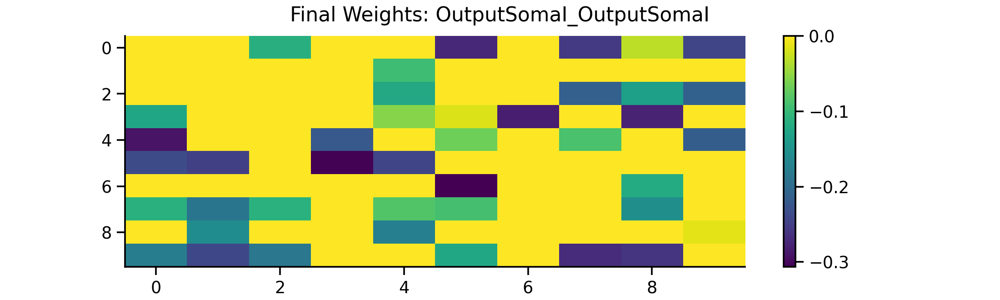

<IPython.core.display.Javascript object>


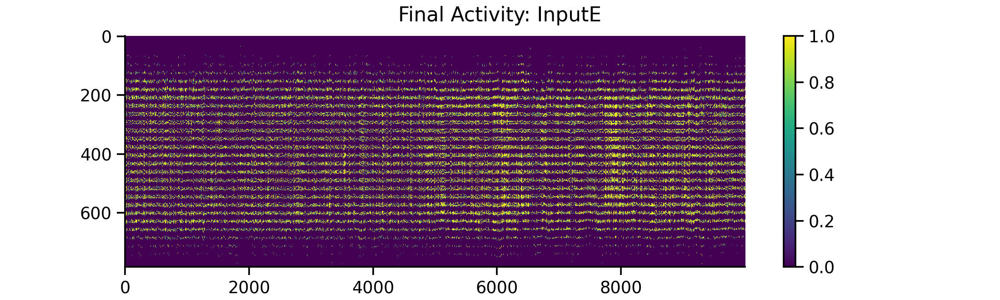

<IPython.core.display.Javascript object>


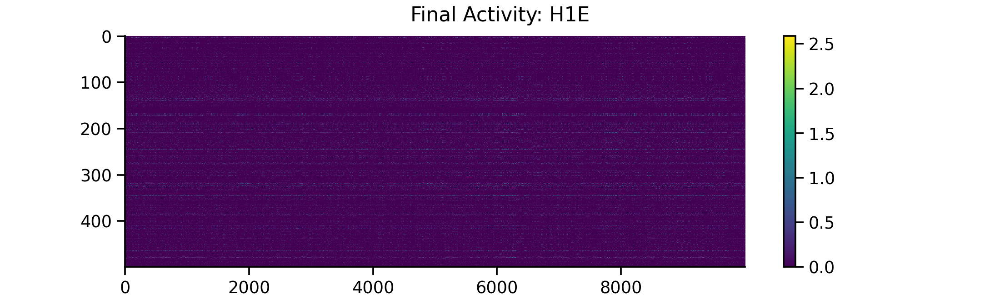

<IPython.core.display.Javascript object>


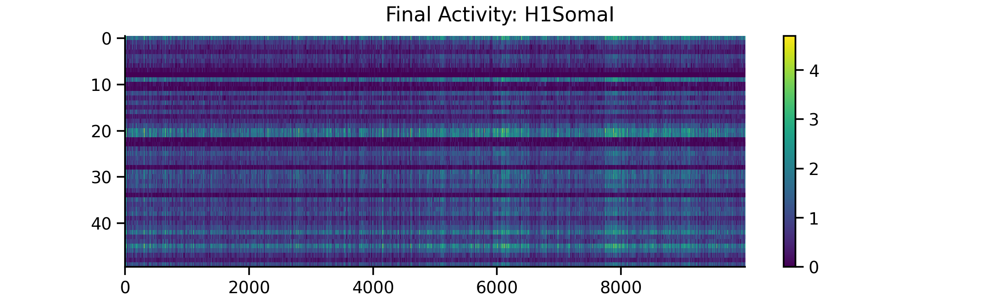

<IPython.core.display.Javascript object>


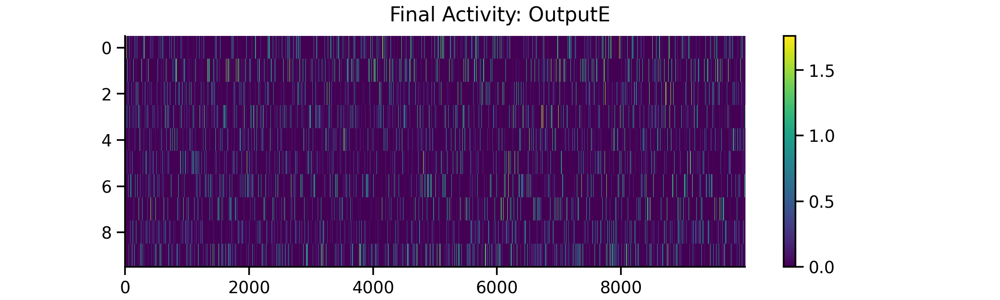

<IPython.core.display.Javascript object>


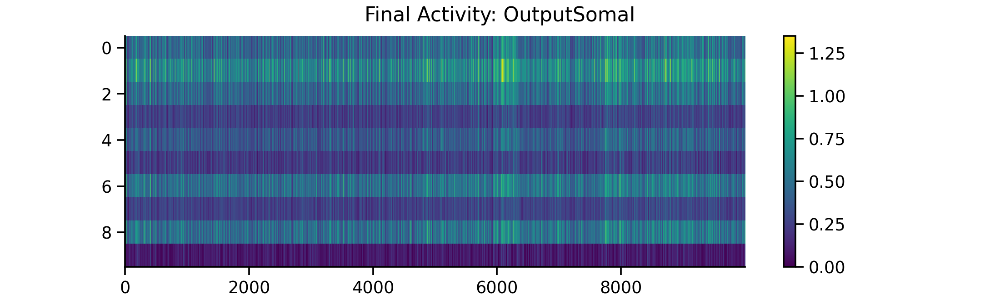

In [21]:
# Create network

config_file_path = '../optimize/data/mnist/20231109_EIANN_1_hidden_mnist_BP_like_config_1_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231109_EIANN_1_hidden_mnist_BP_like_config_1_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

bp_like_1_network = get_network(config_file_path, network_seed)
# plot_network_state(bp_like_1_network, test_dataloader, title='Initial')

train_mnist_network(bp_like_1_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

# plot_network_state(bp_like_1_network, test_dataloader, title='Final')

Batch accuracy = 90.91999816894531%


<IPython.core.display.Javascript object>


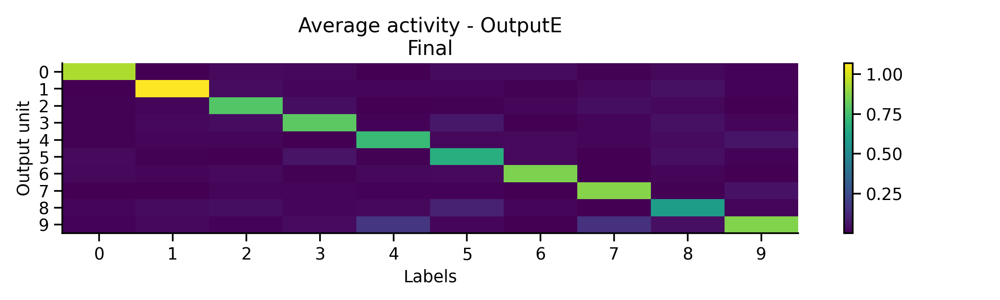

<IPython.core.display.Javascript object>


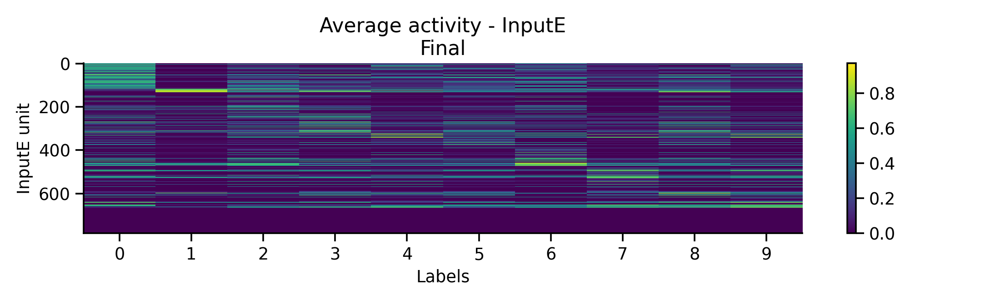

<IPython.core.display.Javascript object>


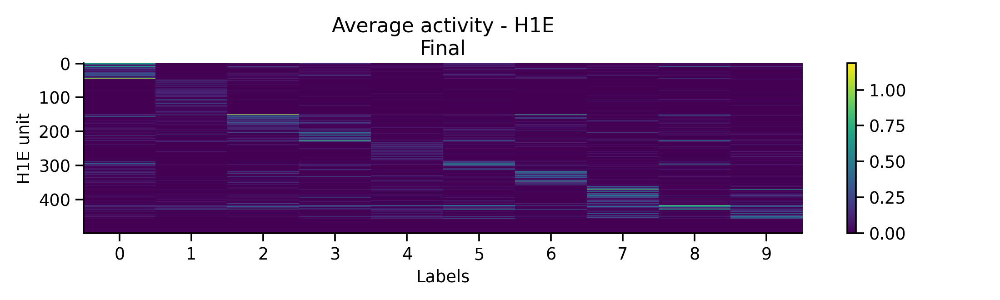

<IPython.core.display.Javascript object>


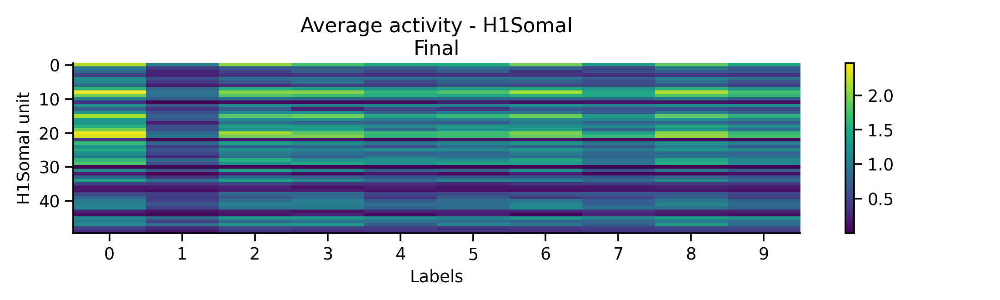

<IPython.core.display.Javascript object>


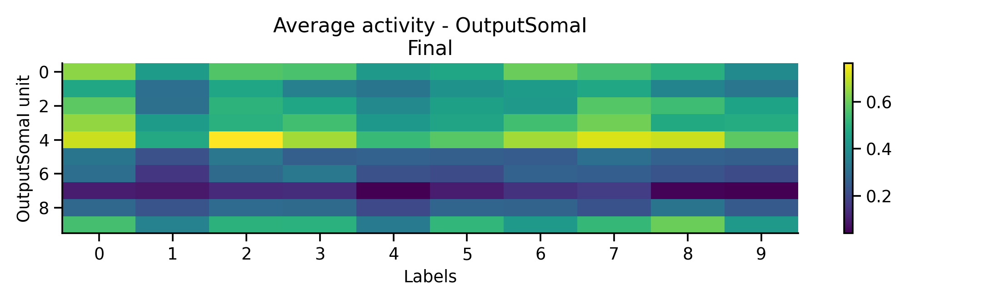

<IPython.core.display.Javascript object>


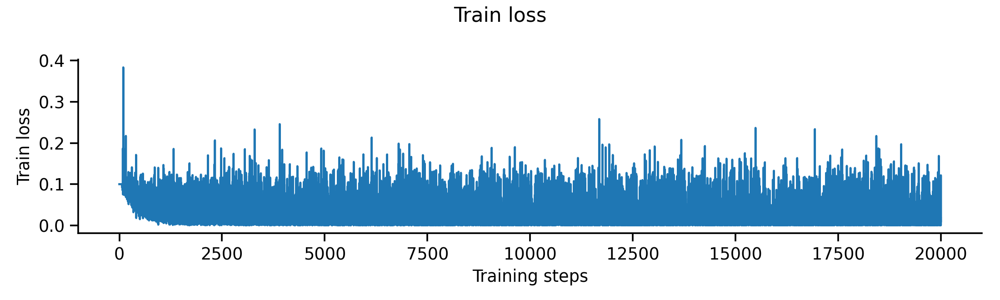

<IPython.core.display.Javascript object>


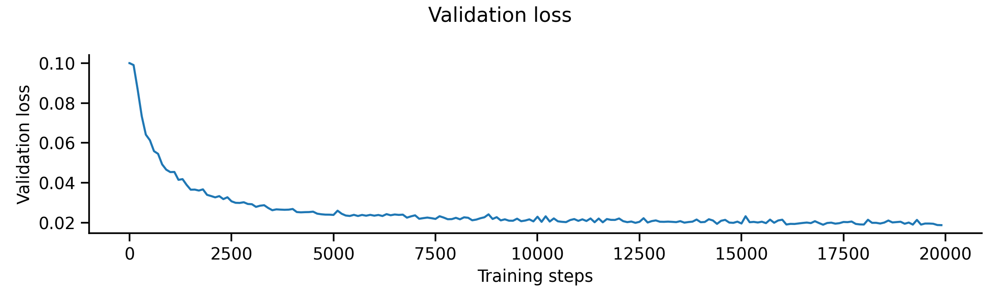

<IPython.core.display.Javascript object>


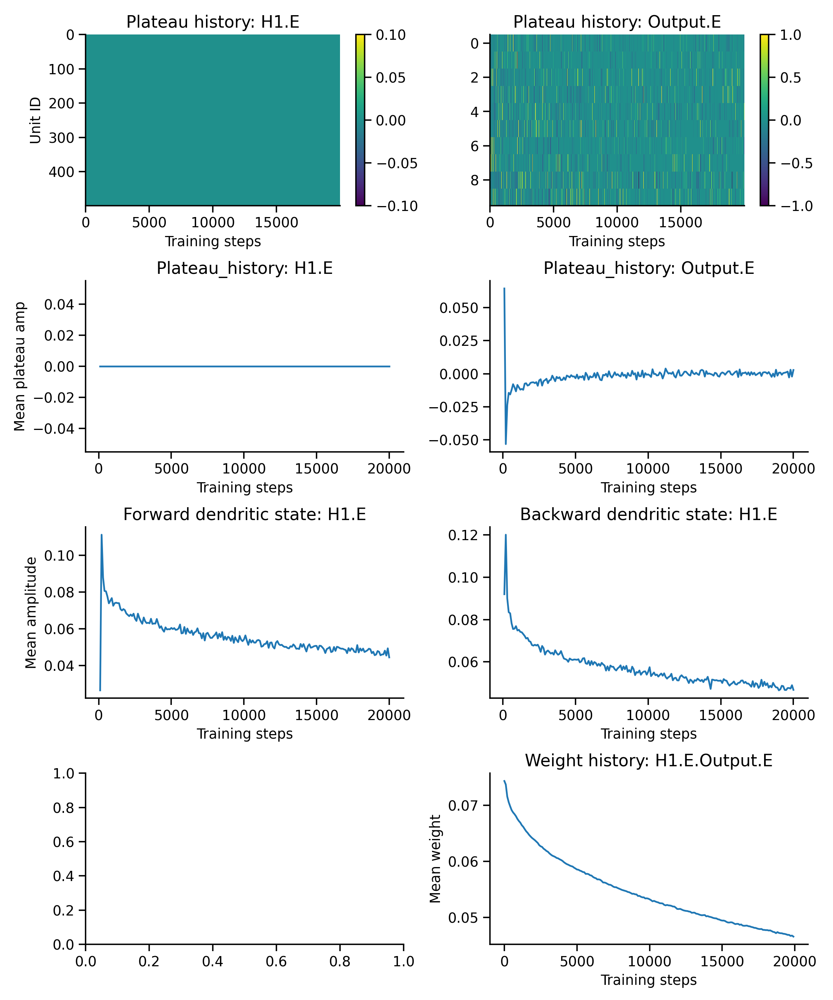

In [27]:
plot_mnist_network_accuracy(bp_like_1_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_1_network)

## BP_like_1B

In [9]:
# Create network

config_file_path = '../optimize/data/mnist/20231120_EIANN_1_hidden_mnist_BP_like_config_1B_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231120_EIANN_1_hidden_mnist_BP_like_config_1B_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

bp_like_1B_network = get_network(config_file_path, network_seed)

train_mnist_network(bp_like_1B_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)


Loading model data from '../optimize/data/mnist/20231120_EIANN_1_hidden_mnist_BP_like_config_1B_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231120_EIANN_1_hidden_mnist_BP_like_config_1B_66049_257_complete.pkl'


Batch accuracy = 89.91999816894531%


<IPython.core.display.Javascript object>


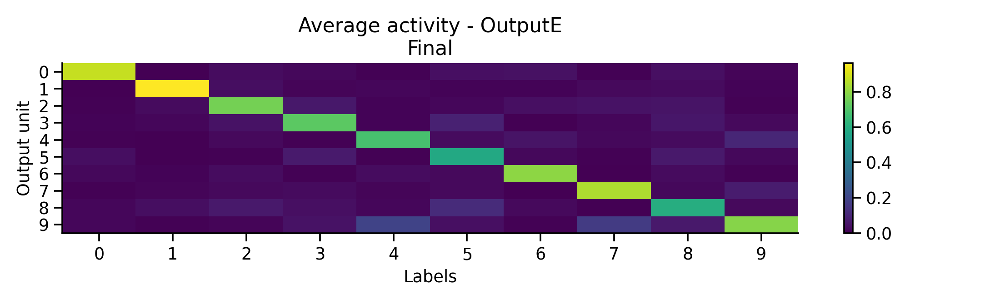

<IPython.core.display.Javascript object>


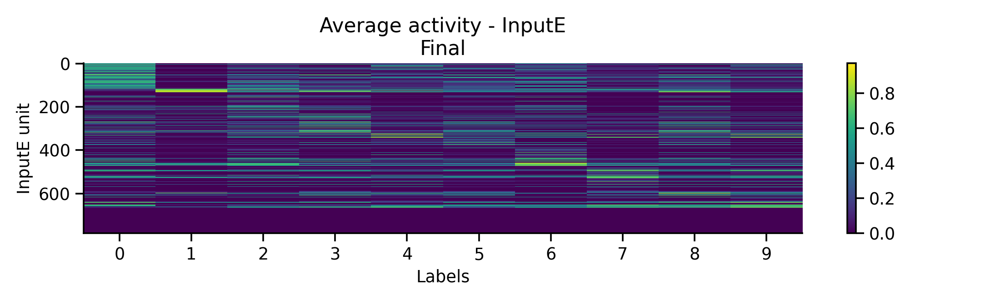

<IPython.core.display.Javascript object>


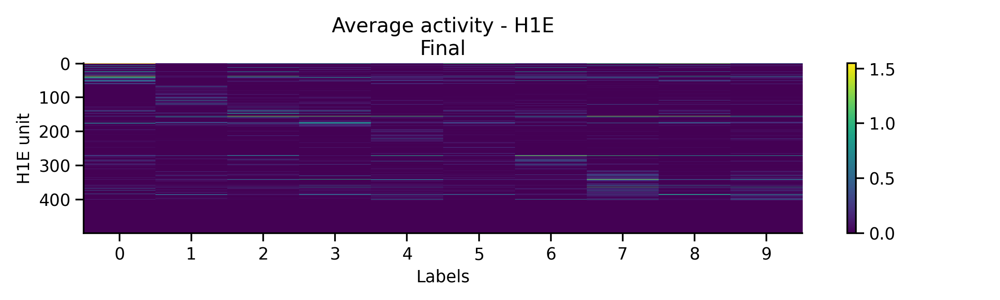

<IPython.core.display.Javascript object>


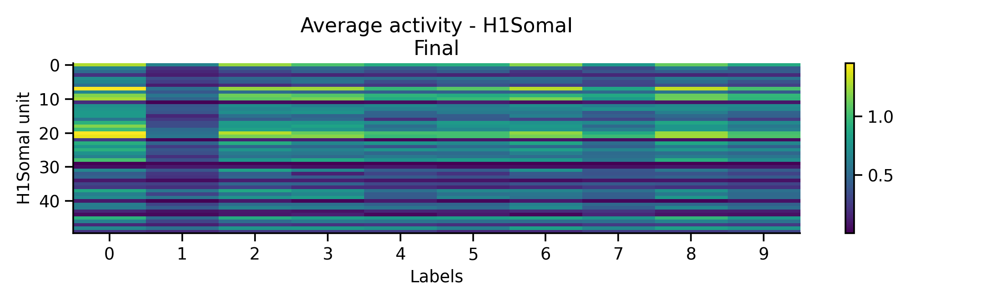

<IPython.core.display.Javascript object>


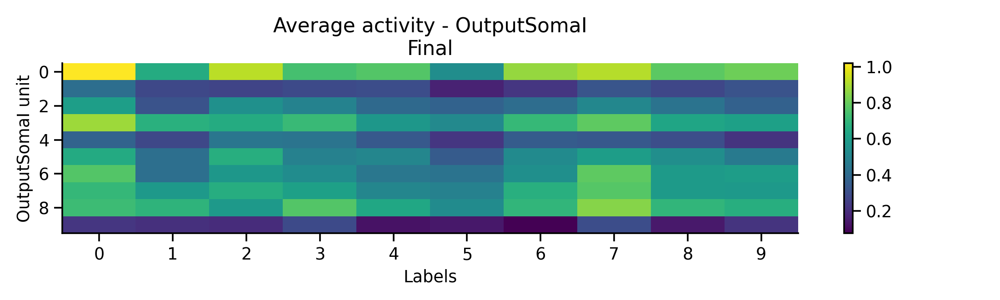

<IPython.core.display.Javascript object>


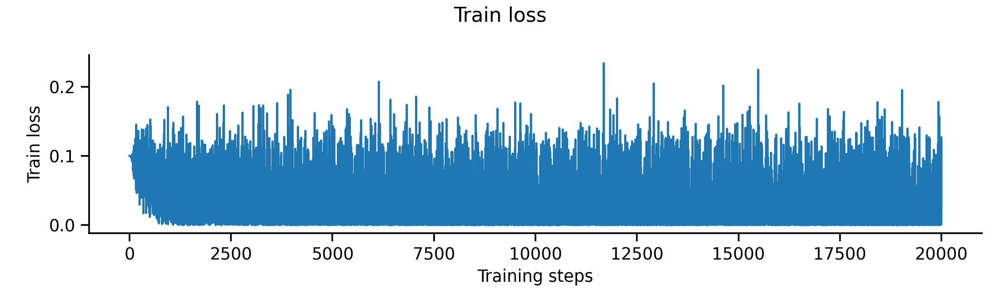

<IPython.core.display.Javascript object>


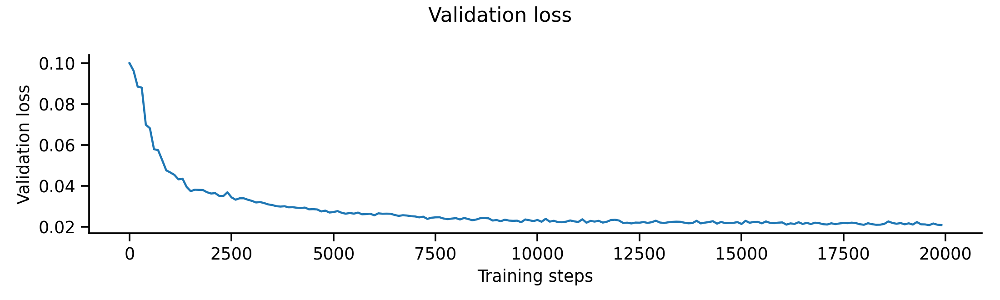

<IPython.core.display.Javascript object>


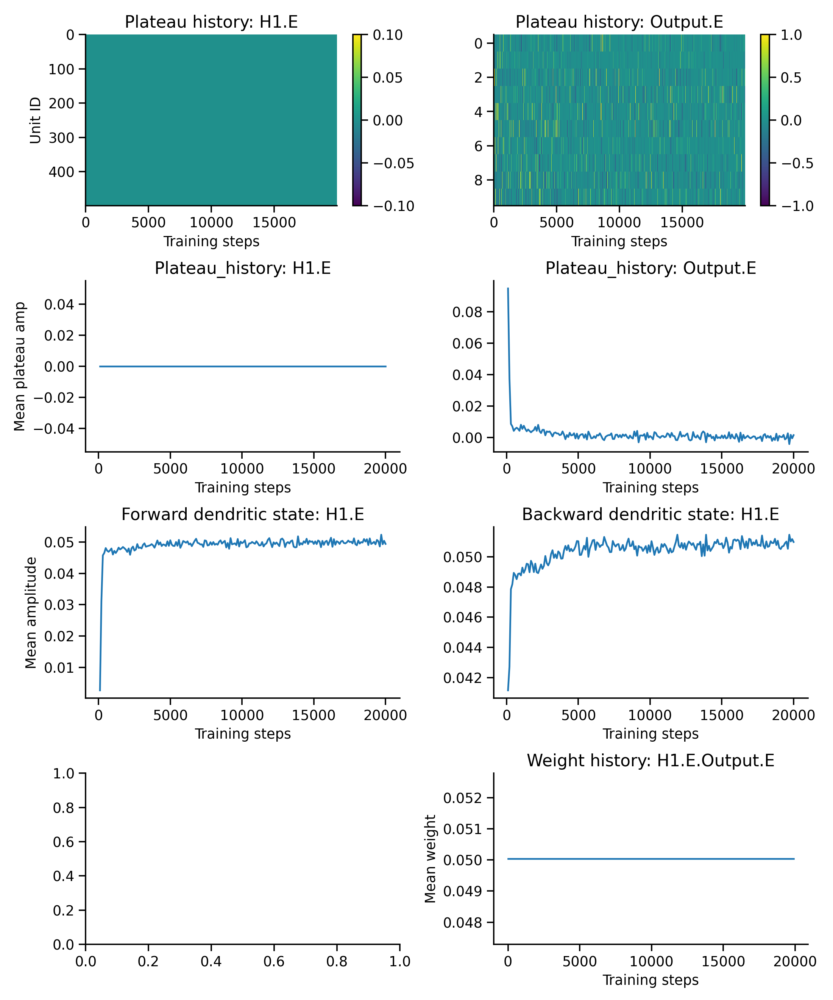

In [10]:
plot_mnist_network_accuracy(bp_like_1B_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_1B_network)

## BP_like_2A

In [41]:
# Create network

config_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2A_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2A_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

bp_like_2A_network = get_network(config_file_path, network_seed)

train_mnist_network(bp_like_2A_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)


Loading model data from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2A_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2A_66049_257_complete.pkl'


Batch accuracy = 90.30000305175781%


<IPython.core.display.Javascript object>


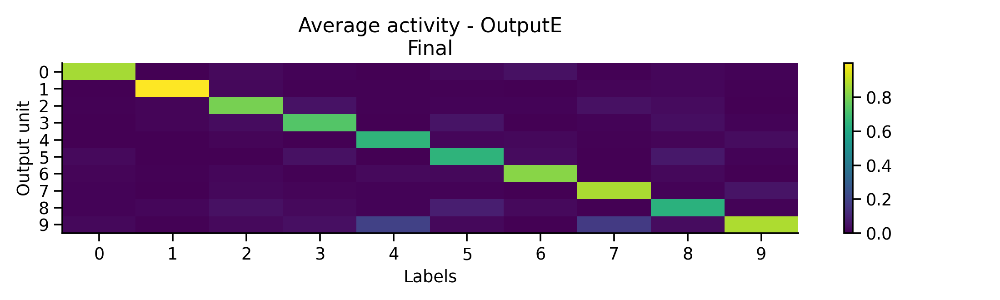

<IPython.core.display.Javascript object>


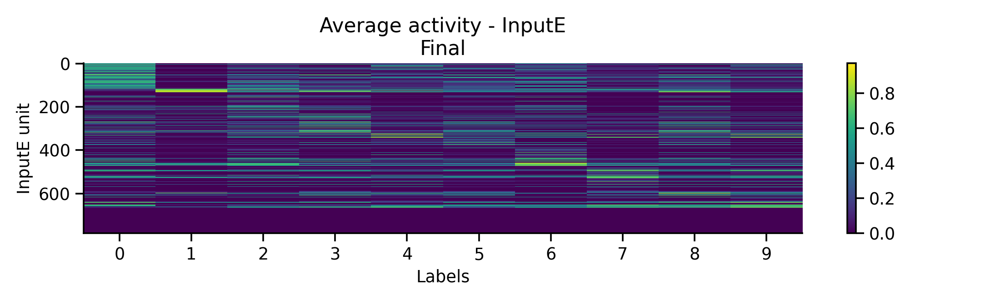

<IPython.core.display.Javascript object>


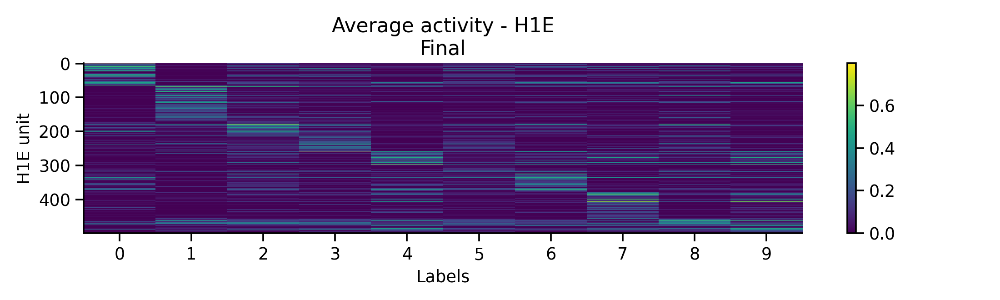

<IPython.core.display.Javascript object>


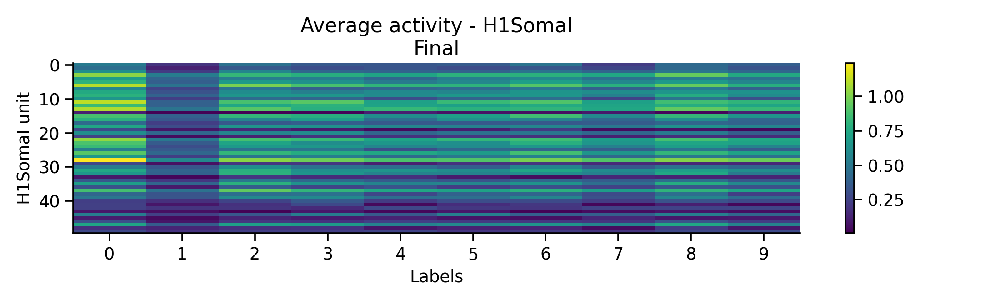

<IPython.core.display.Javascript object>


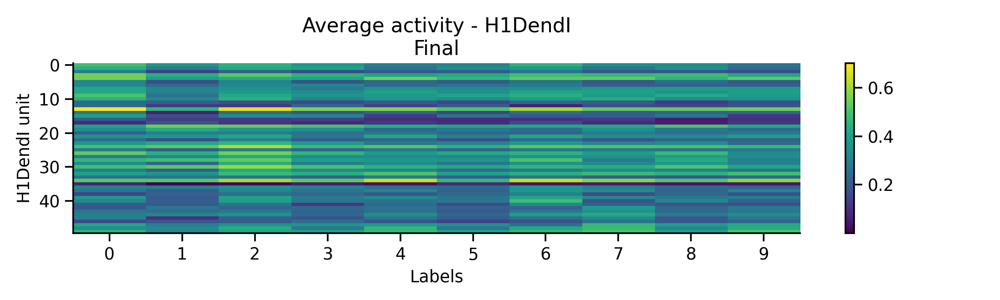

<IPython.core.display.Javascript object>


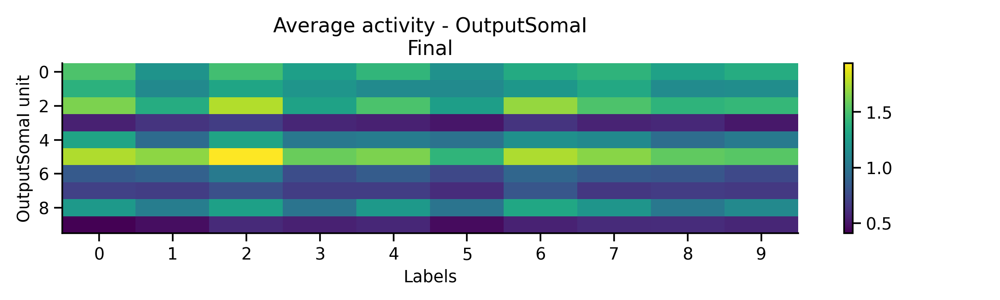

<IPython.core.display.Javascript object>


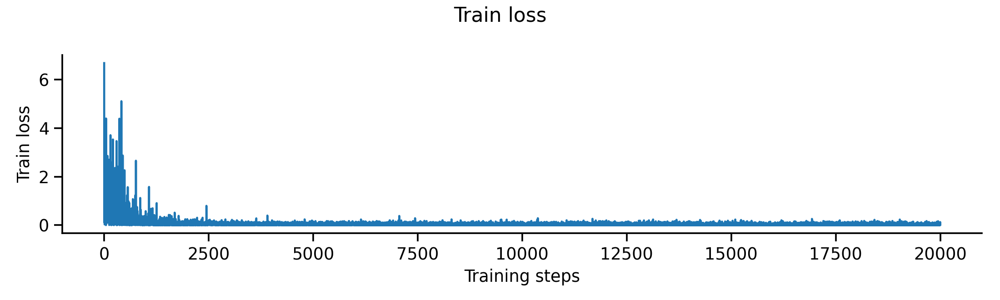

<IPython.core.display.Javascript object>


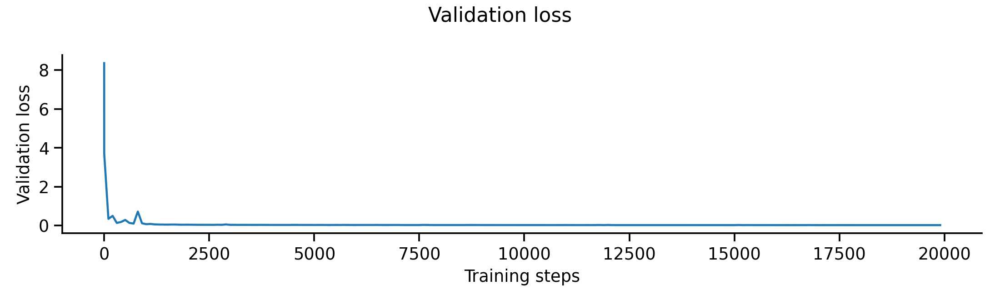

<IPython.core.display.Javascript object>


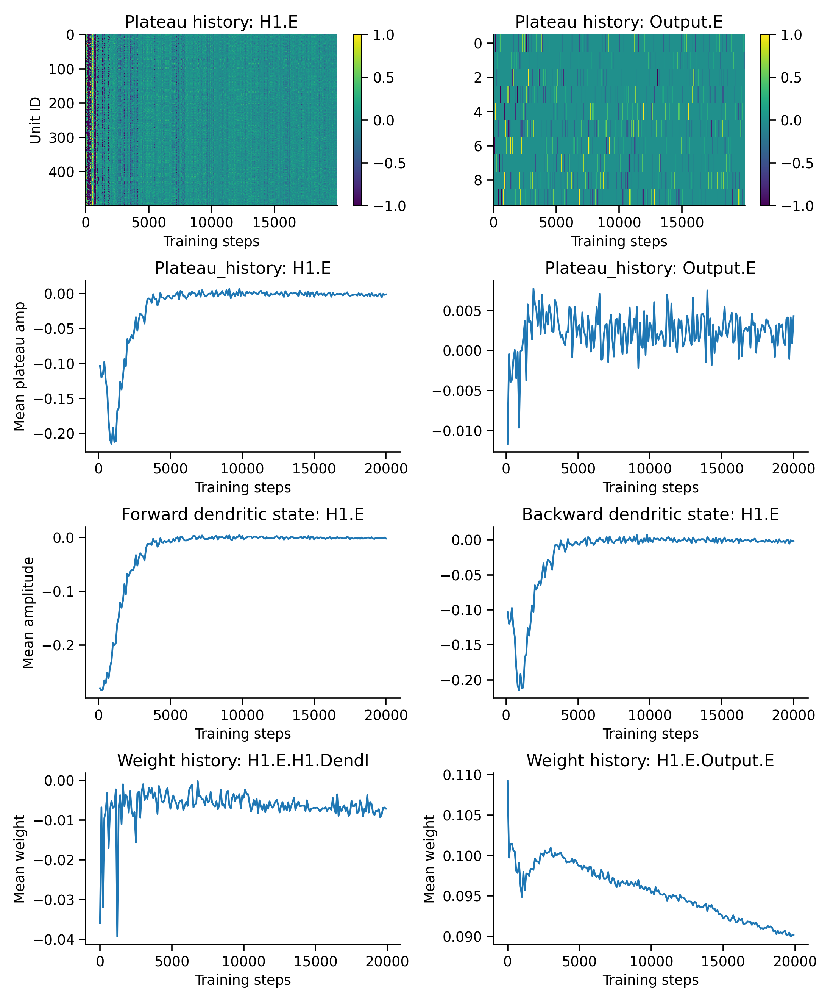

In [42]:
plot_mnist_network_accuracy(bp_like_2A_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_2A_network)

## BP_like_2B

Loading model data from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2B_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2B_66049_257_complete.pkl'
Batch accuracy = 87.95999908447266%


<IPython.core.display.Javascript object>


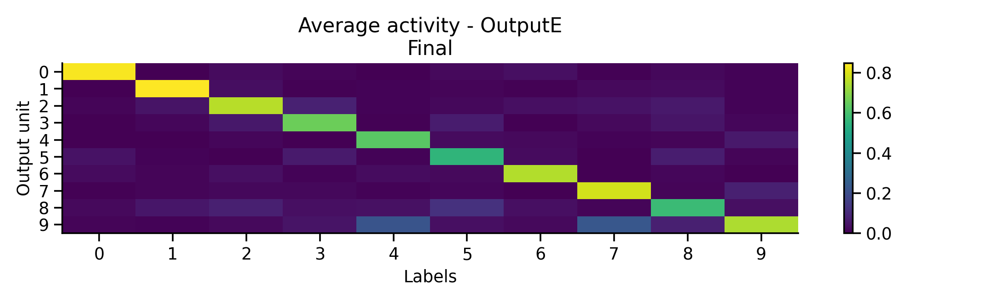

<IPython.core.display.Javascript object>


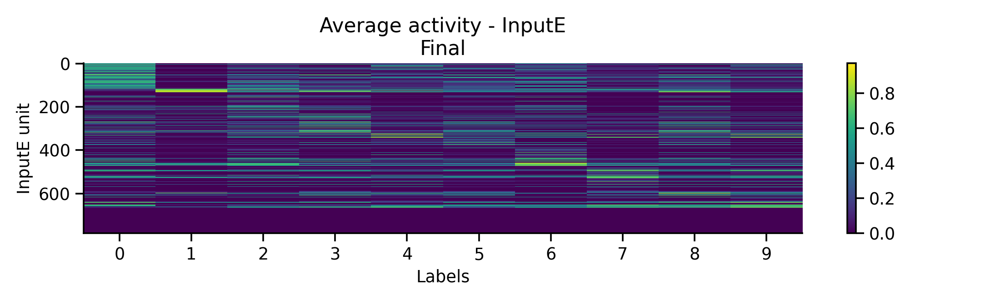

<IPython.core.display.Javascript object>


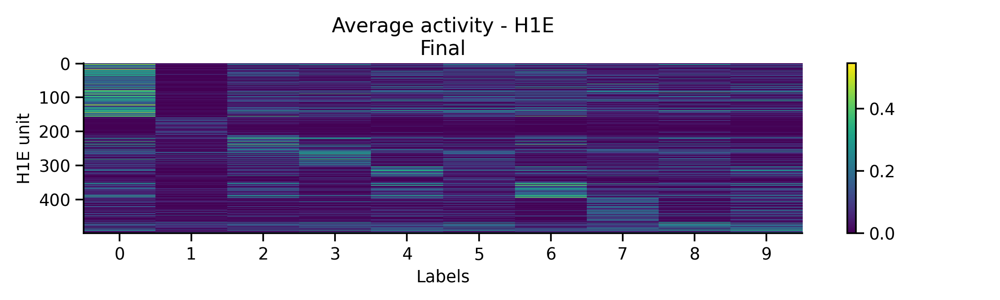

<IPython.core.display.Javascript object>


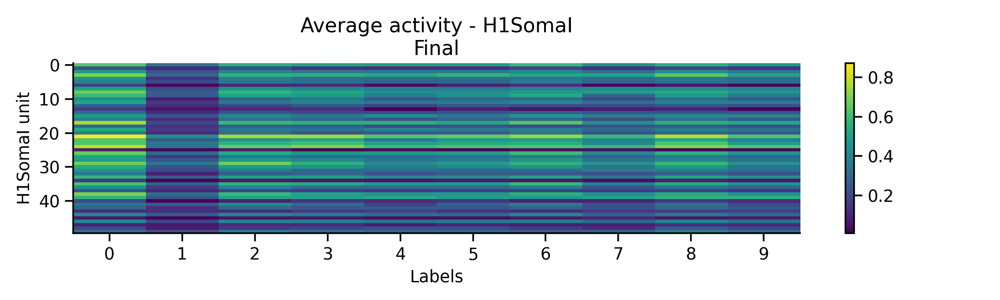

<IPython.core.display.Javascript object>


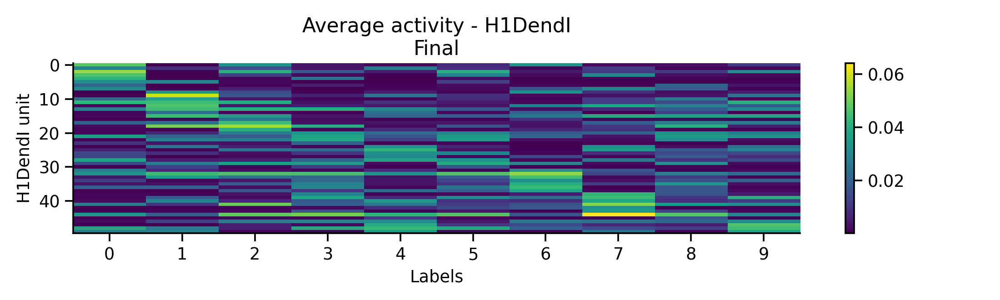

<IPython.core.display.Javascript object>


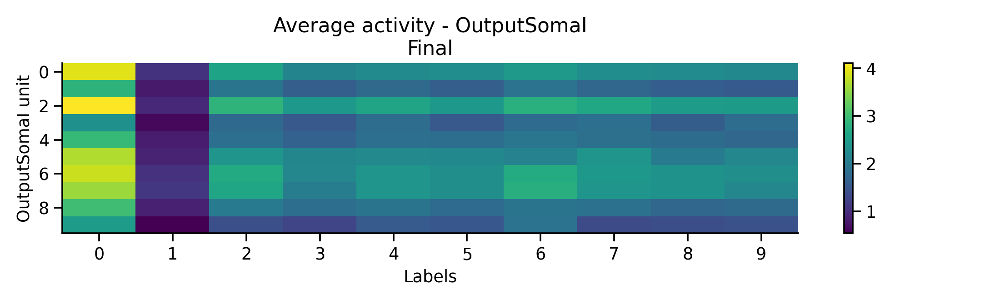

<IPython.core.display.Javascript object>


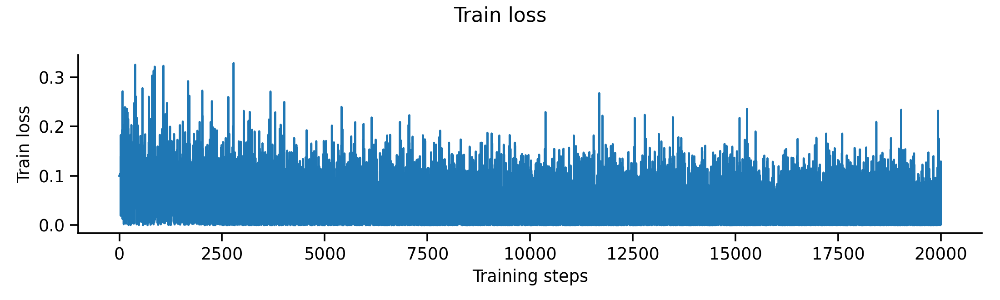

<IPython.core.display.Javascript object>


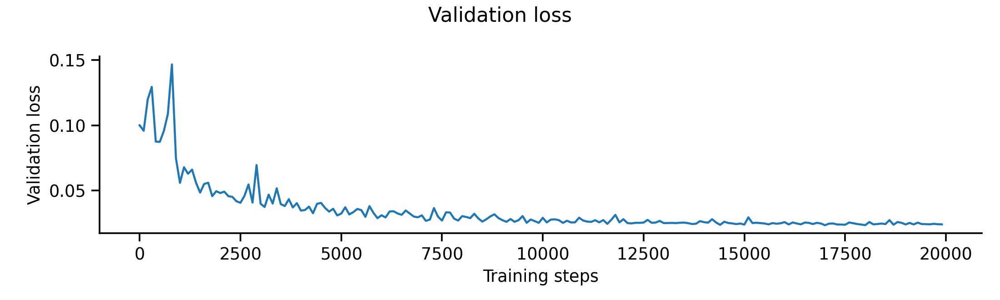

<IPython.core.display.Javascript object>


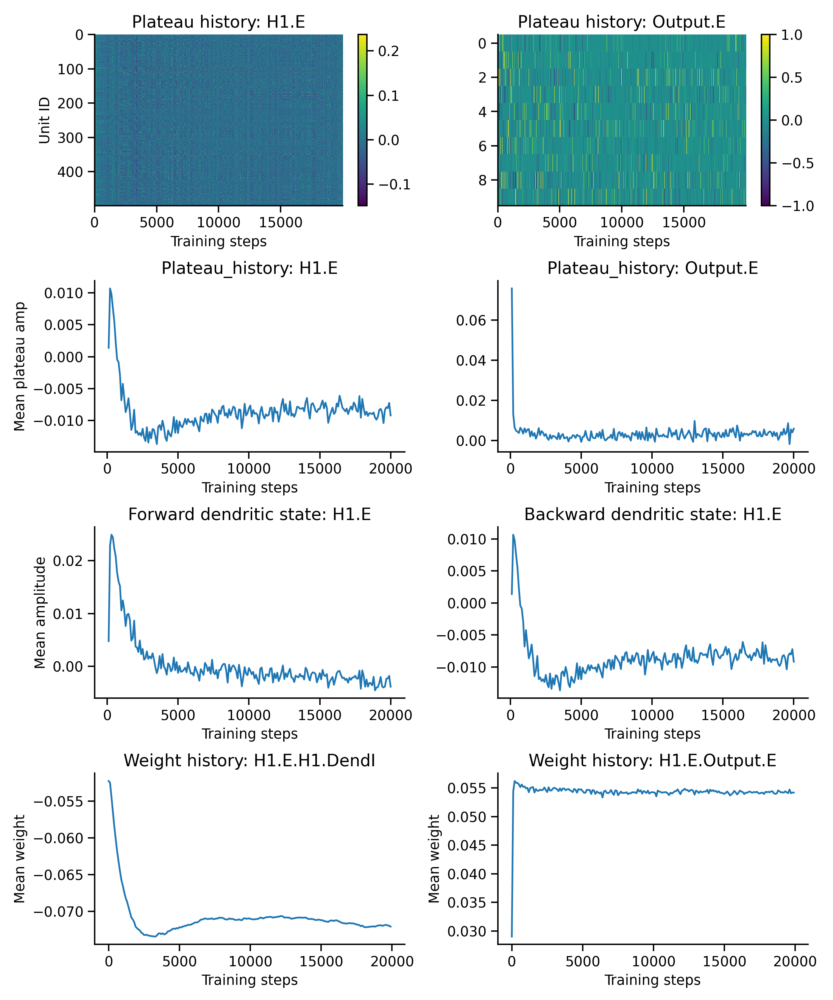

In [12]:
# Create network

config_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2B_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2B_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

bp_like_2B_network = get_network(config_file_path, network_seed)

train_mnist_network(bp_like_2B_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

plot_mnist_network_accuracy(bp_like_2B_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_2B_network)

## BP_like_2C

In [61]:
# Create network

config_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2C_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2C_66049_257_history.pkl'

data_generator.manual_seed(data_seed)

bp_like_2C_network = get_network(config_file_path, network_seed)

train_mnist_network(bp_like_2C_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

Loading model data from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2C_66049_257_history.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231110_EIANN_1_hidden_mnist_BP_like_config_2C_66049_257_history.pkl'


Batch accuracy = 90.19000244140625%


<IPython.core.display.Javascript object>


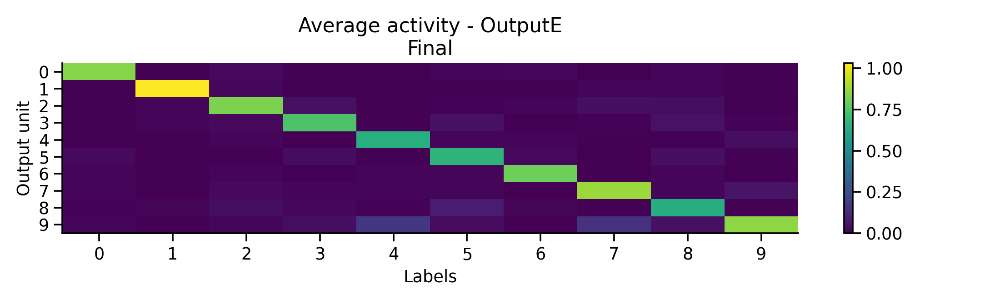

<IPython.core.display.Javascript object>


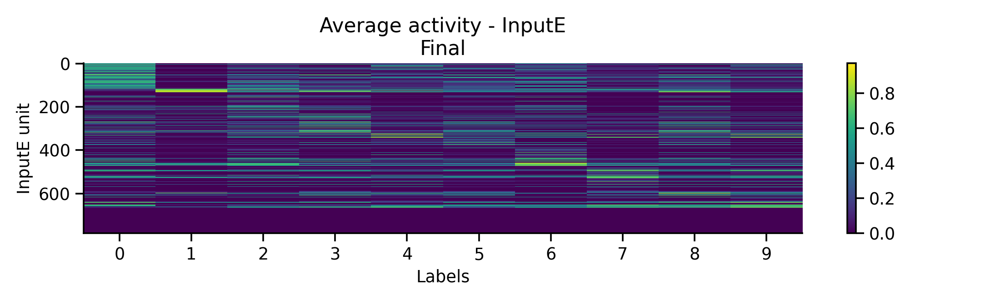

<IPython.core.display.Javascript object>


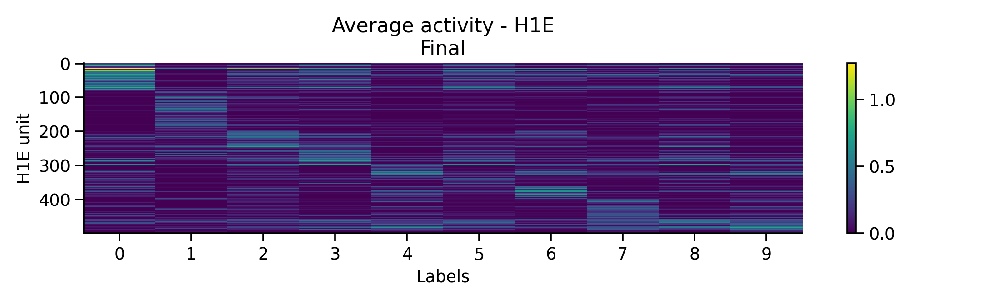

<IPython.core.display.Javascript object>


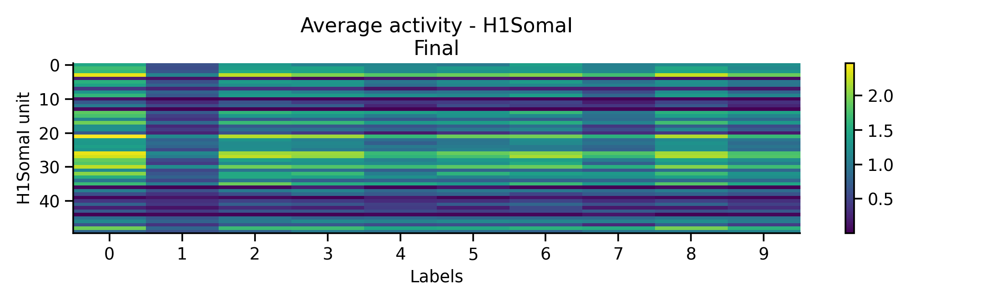

<IPython.core.display.Javascript object>


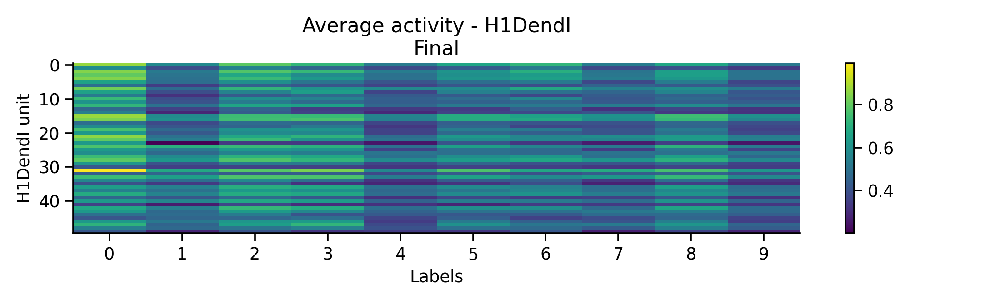

<IPython.core.display.Javascript object>


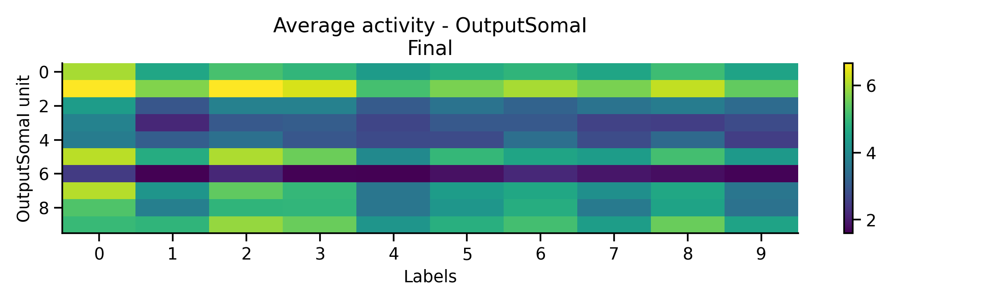

<IPython.core.display.Javascript object>


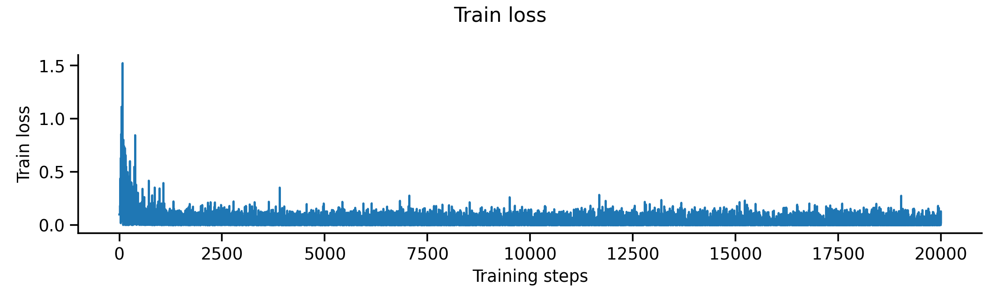

<IPython.core.display.Javascript object>


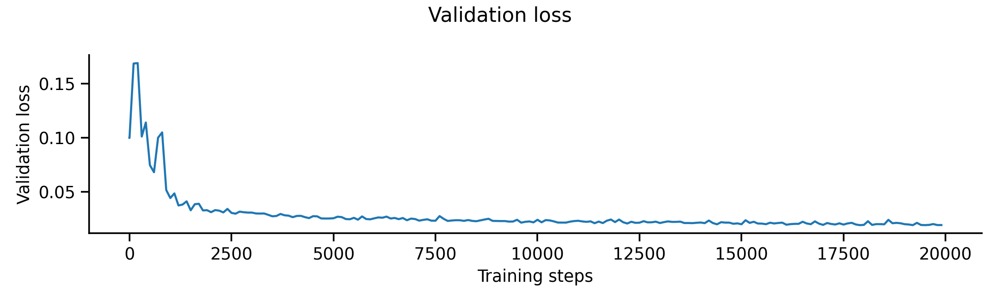

<IPython.core.display.Javascript object>


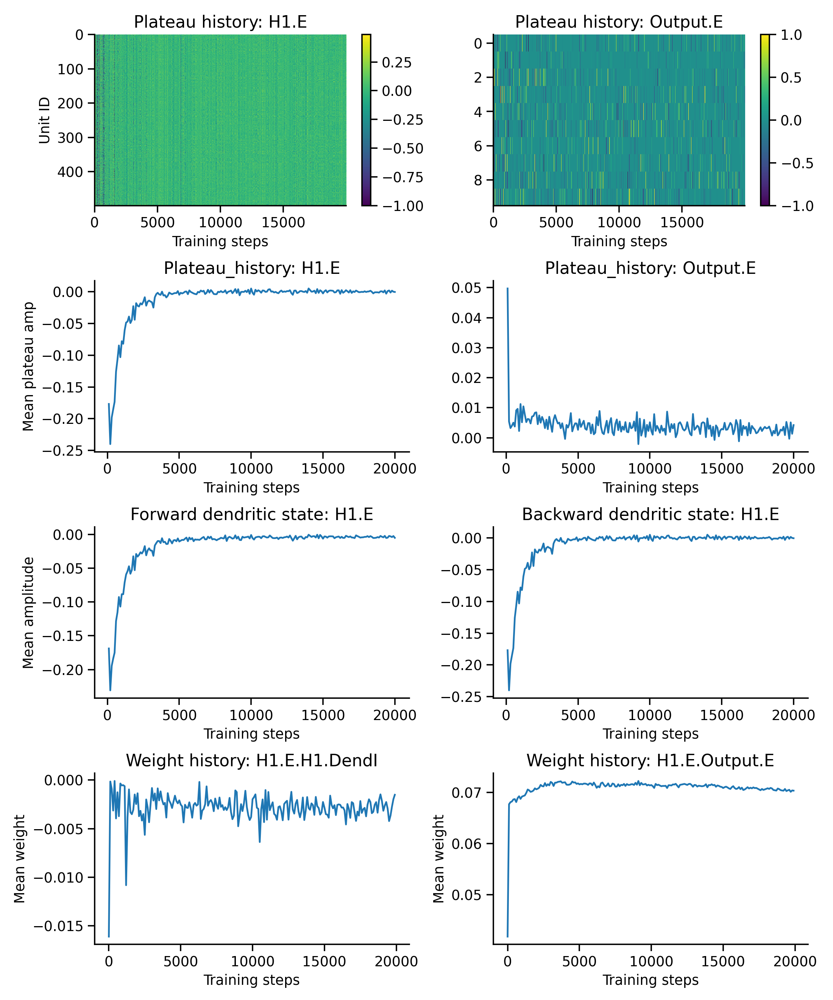

In [62]:
plot_mnist_network_accuracy(bp_like_2C_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_2C_network)

## BP_like_3A

Loading model data from '../optimize/data/mnist/20231121_EIANN_1_hidden_mnist_BP_like_config_3A_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231121_EIANN_1_hidden_mnist_BP_like_config_3A_66049_257_complete.pkl'
Batch accuracy = 90.7300033569336%


<IPython.core.display.Javascript object>


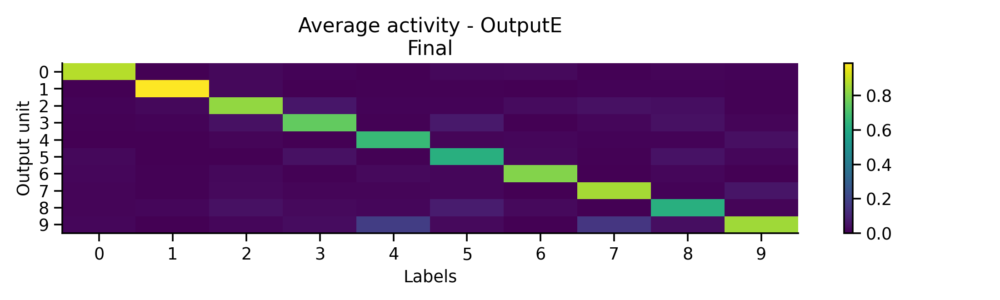

<IPython.core.display.Javascript object>


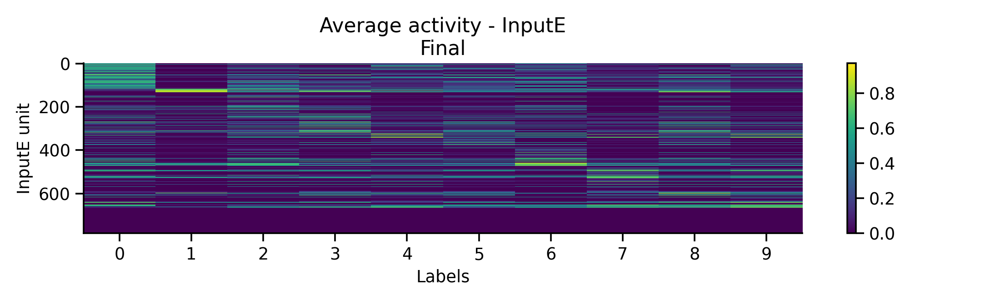

<IPython.core.display.Javascript object>


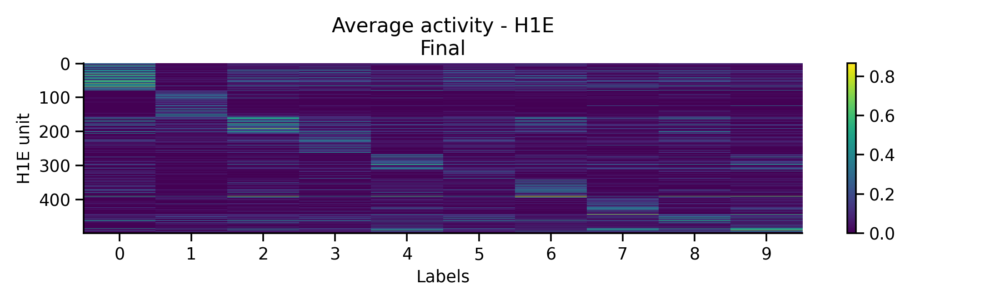

/Users/aaronmil/src/EIANN/EIANN/plot.py:646: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots()


<IPython.core.display.Javascript object>


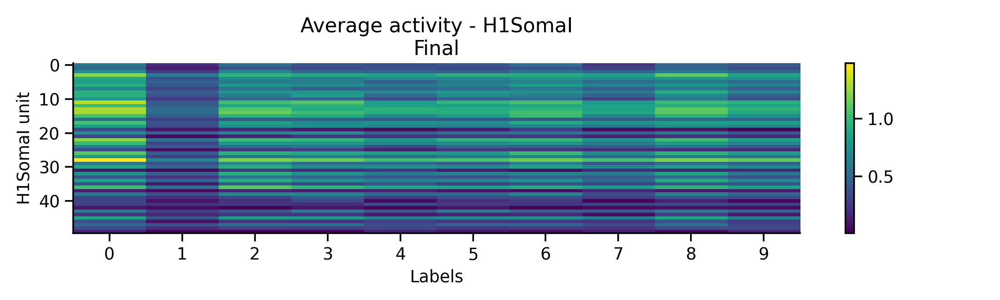

<IPython.core.display.Javascript object>


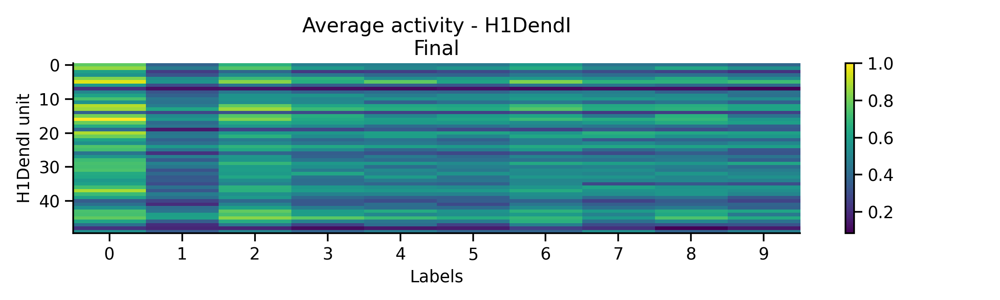

<IPython.core.display.Javascript object>


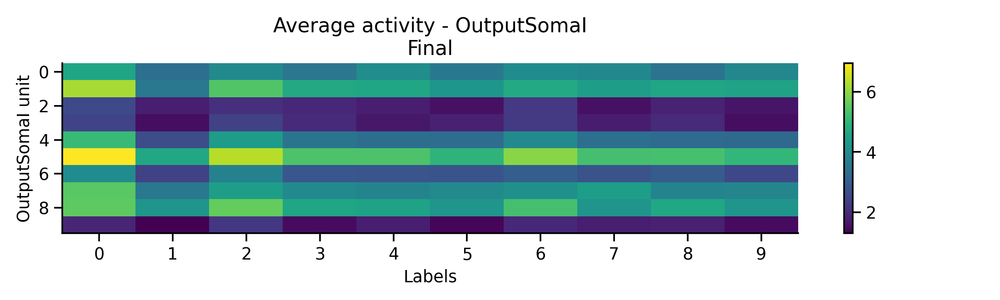

<IPython.core.display.Javascript object>


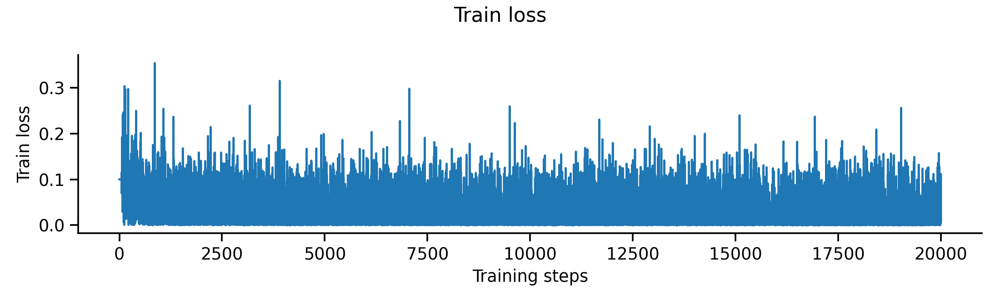

<IPython.core.display.Javascript object>


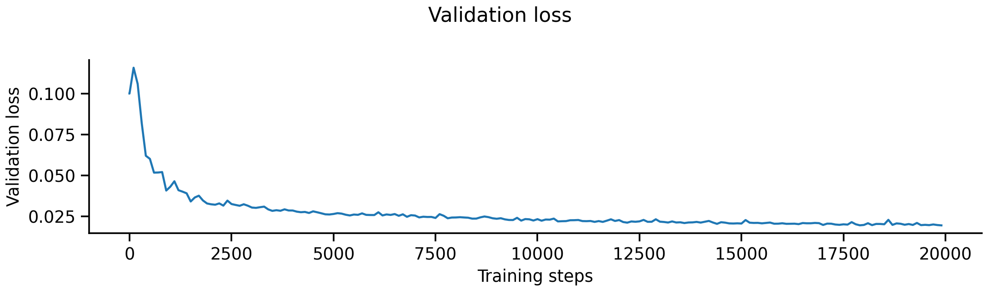

<IPython.core.display.Javascript object>


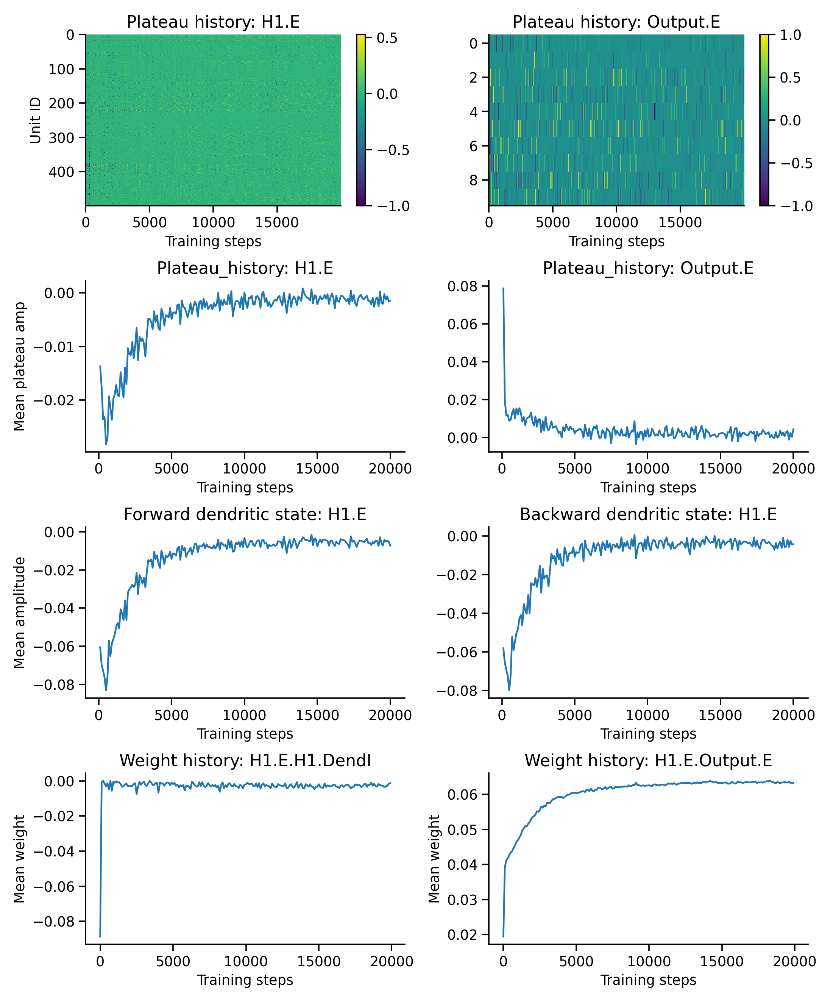

In [13]:
# Create network

config_file_path = '../optimize/data/mnist/20231121_EIANN_1_hidden_mnist_BP_like_config_3A_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231121_EIANN_1_hidden_mnist_BP_like_config_3A_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

bp_like_3A_network = get_network(config_file_path, network_seed)

train_mnist_network(bp_like_3A_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

plot_mnist_network_accuracy(bp_like_3A_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(bp_like_3A_network)

## BTSP_cont_J

In [59]:
# Create network

config_file_path = '../optimize/data/mnist/20231025_nested_optimize_EIANN_1_hidden_mnist_BTSP_cont_config_J_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J_66049_257_history.pkl'

data_generator.manual_seed(data_seed)

btsp_cont_J_network = get_network(config_file_path, network_seed)

train_mnist_network(btsp_cont_J_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

Loading model data from '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J_66049_257_history.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J_66049_257_history.pkl'


Batch accuracy = 85.0%


<IPython.core.display.Javascript object>


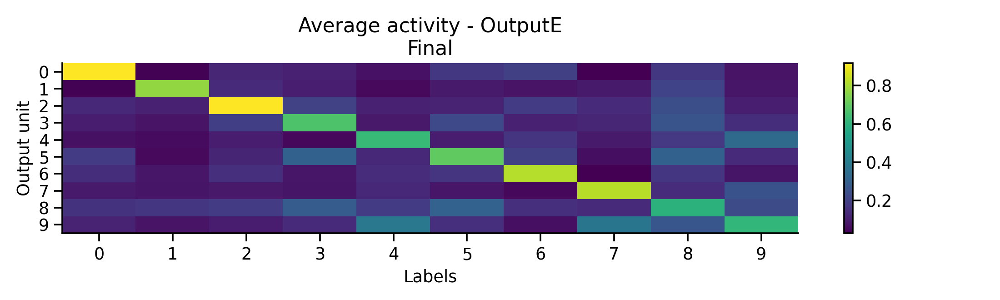

<IPython.core.display.Javascript object>


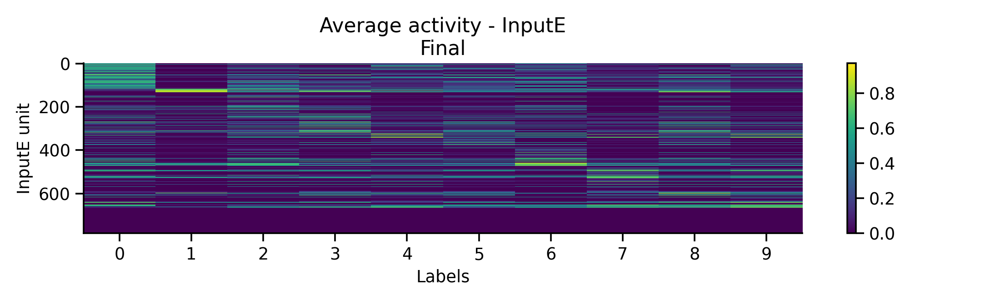

<IPython.core.display.Javascript object>


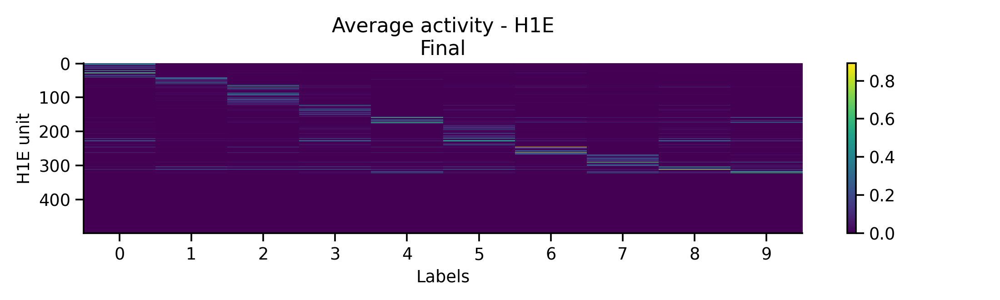

<IPython.core.display.Javascript object>


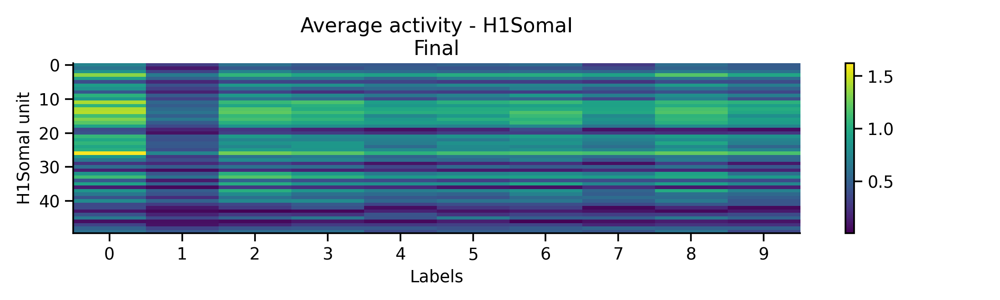

<IPython.core.display.Javascript object>


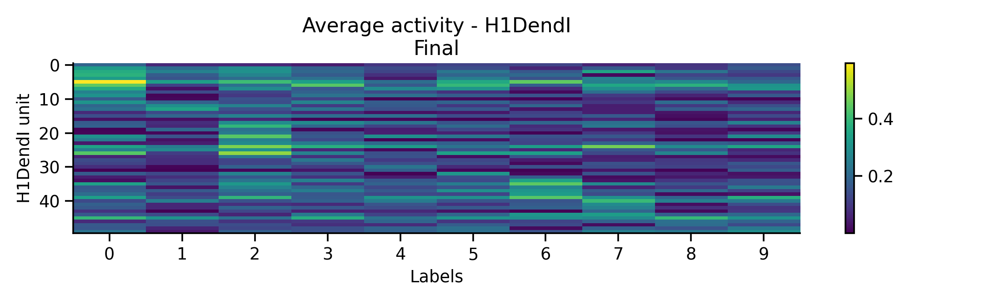

<IPython.core.display.Javascript object>


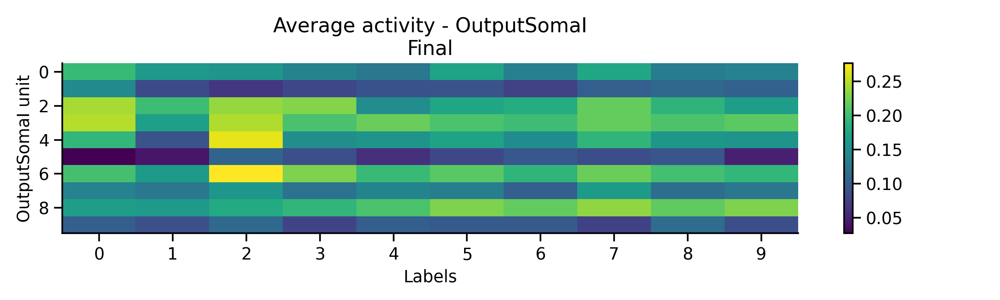

<IPython.core.display.Javascript object>


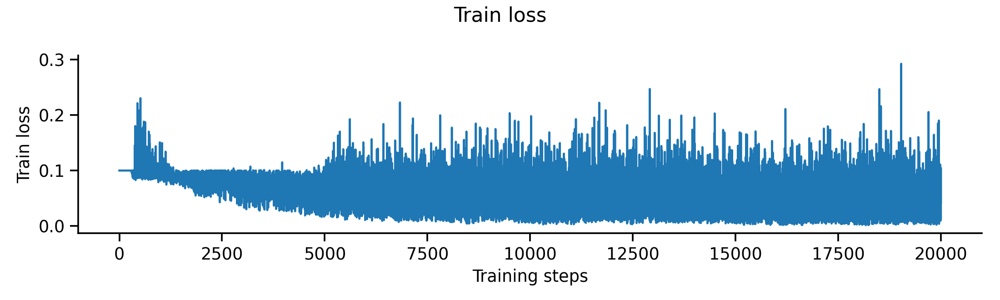

<IPython.core.display.Javascript object>


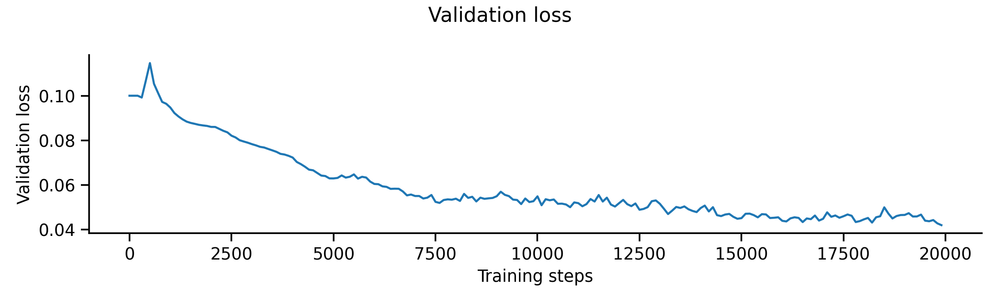

<IPython.core.display.Javascript object>


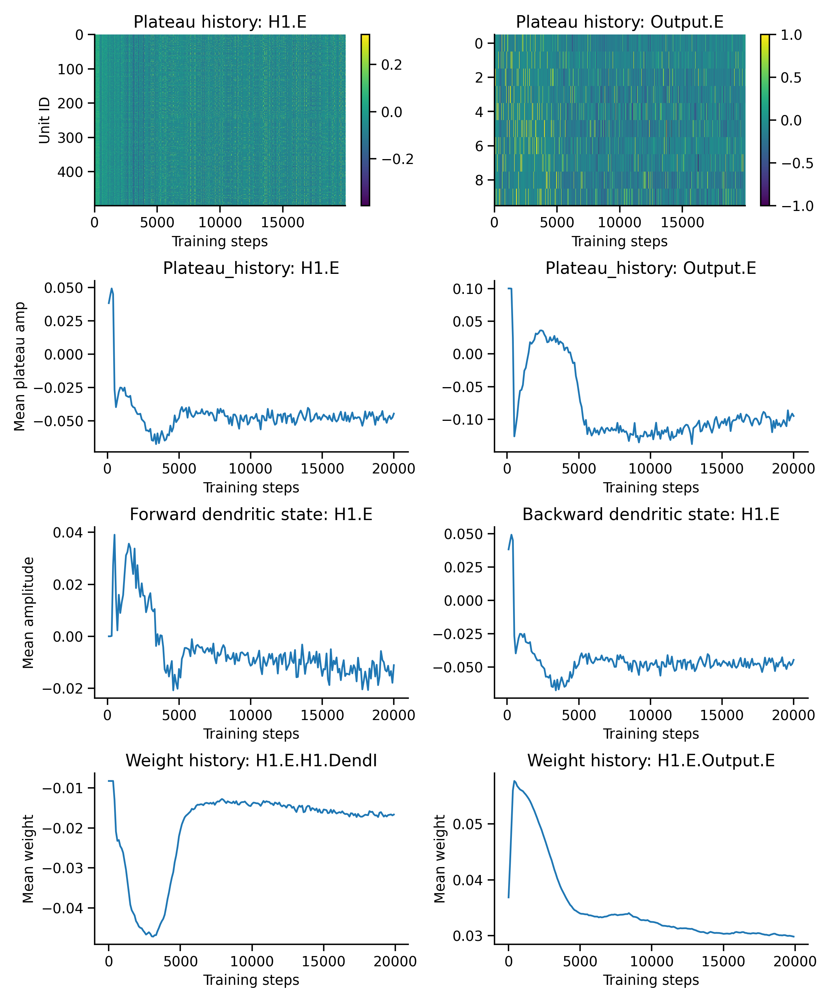

In [60]:
plot_mnist_network_accuracy(btsp_cont_J_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(btsp_cont_J_network)

## BTSP_cont_J3

In [54]:
# Create network

config_file_path = '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J3_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J3_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

btsp_cont_J3_network = get_network(config_file_path, network_seed)

train_mnist_network(btsp_cont_J3_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

Loading model data from '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J3_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231025_EIANN_1_hidden_mnist_BTSP_cont_config_J3_66049_257_complete.pkl'


Batch accuracy = 80.98999786376953%


<IPython.core.display.Javascript object>


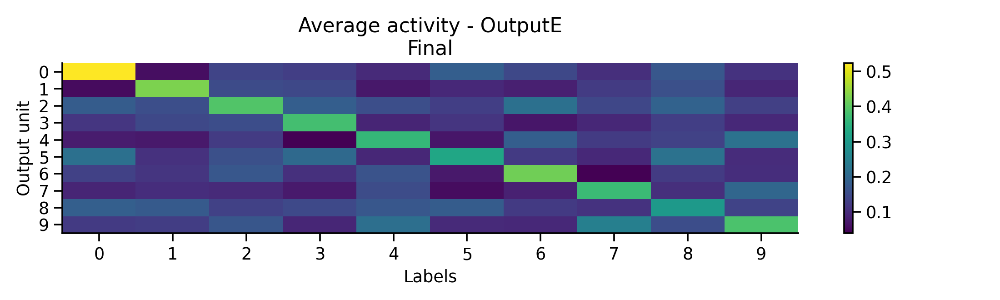

<IPython.core.display.Javascript object>


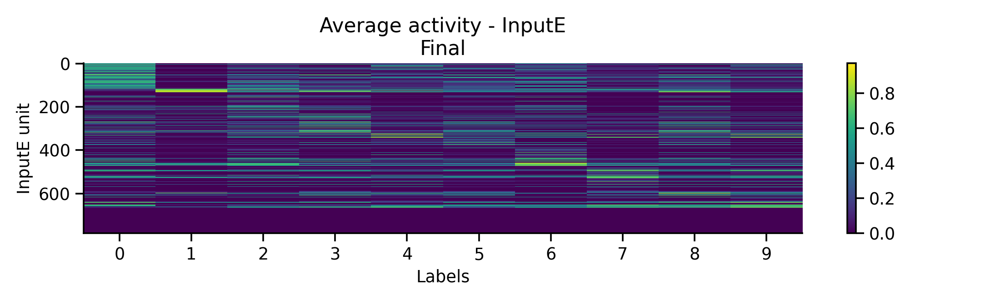

<IPython.core.display.Javascript object>


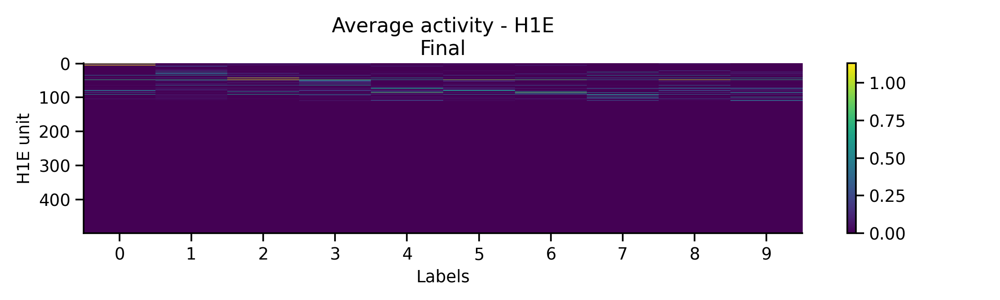

<IPython.core.display.Javascript object>


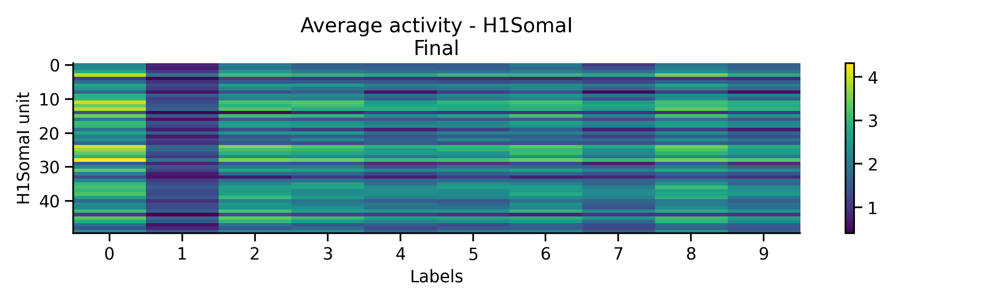

<IPython.core.display.Javascript object>


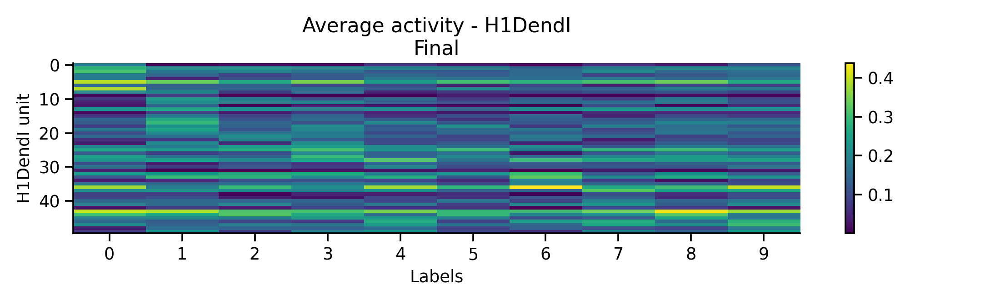

<IPython.core.display.Javascript object>


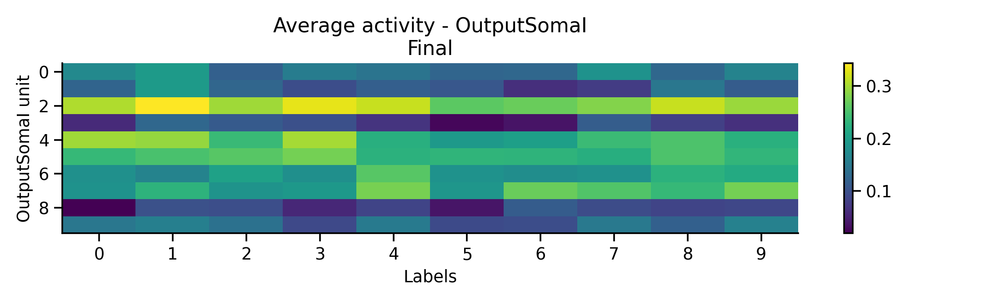

<IPython.core.display.Javascript object>


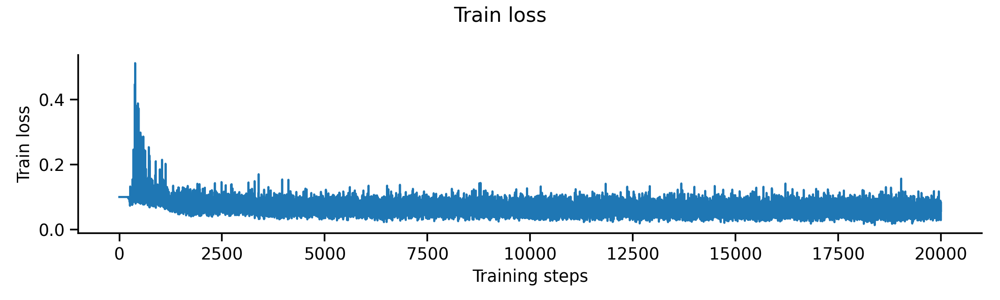

<IPython.core.display.Javascript object>


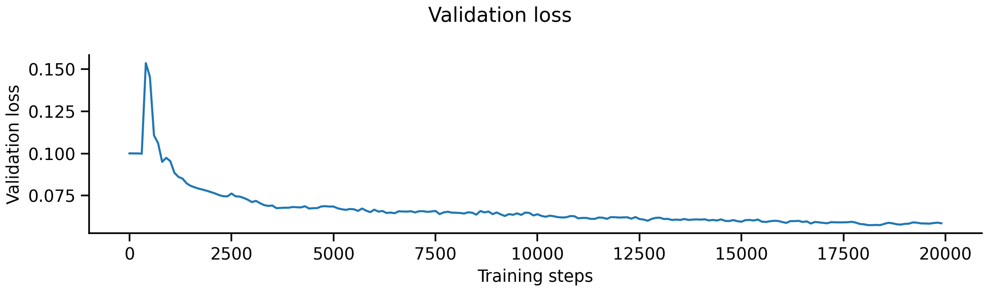

<IPython.core.display.Javascript object>


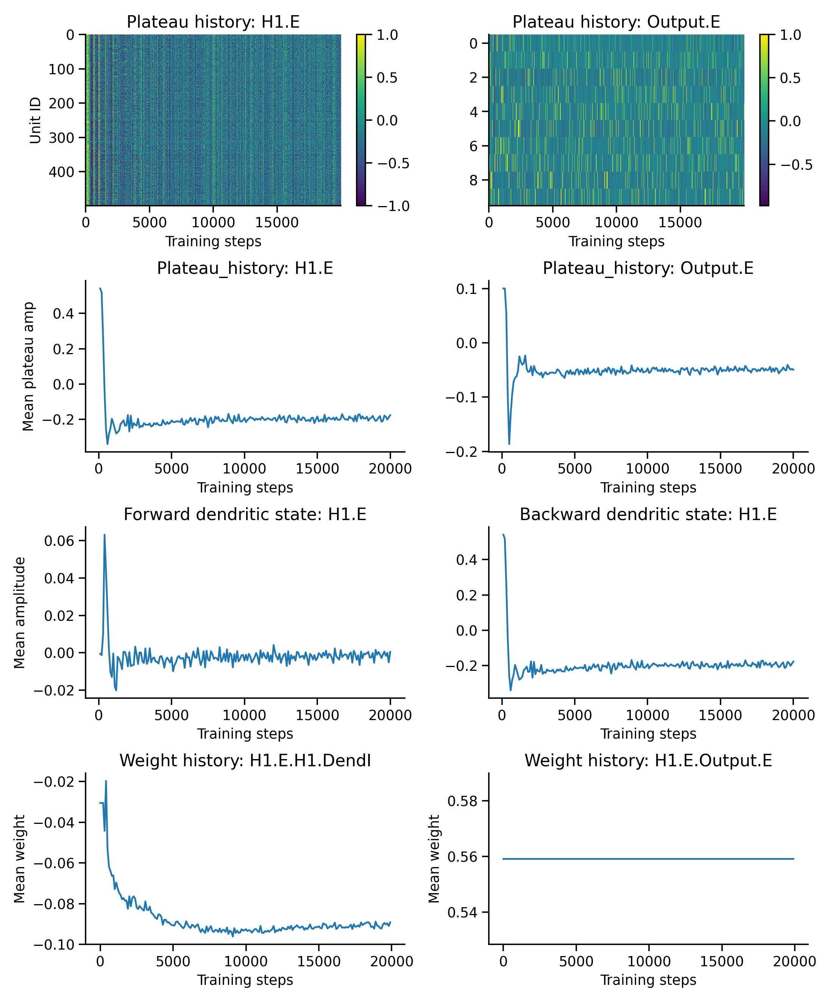

In [55]:
plot_mnist_network_accuracy(btsp_cont_J3_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(btsp_cont_J3_network)

## BTSP_K1

In [52]:
# Create network

config_file_path = '../optimize/data/mnist/20231108_EIANN_1_hidden_mnist_BTSP_config_K1_optimized.yaml'
data_file_path = '../optimize/data/mnist/20231108_EIANN_1_hidden_mnist_BTSP_config_K1_66049_257_complete.pkl'

data_generator.manual_seed(data_seed)

btsp_K1_network = get_network(config_file_path, network_seed)
# plot_network_state(bp_like_1_network, test_dataloader, title='Initial')

train_mnist_network(btsp_K1_network, train_dataloader, val_dataloader, train_steps=20000, data_file_path=data_file_path)

# plot_network_state(bp_like_1_network, test_dataloader, title='Final')

Loading model data from '../optimize/data/mnist/20231108_EIANN_1_hidden_mnist_BTSP_config_K1_66049_257_complete.pkl'...
Loading parameters into the network...
Model successfully loaded from '../optimize/data/mnist/20231108_EIANN_1_hidden_mnist_BTSP_config_K1_66049_257_complete.pkl'


Batch accuracy = 87.63999938964844%


<IPython.core.display.Javascript object>


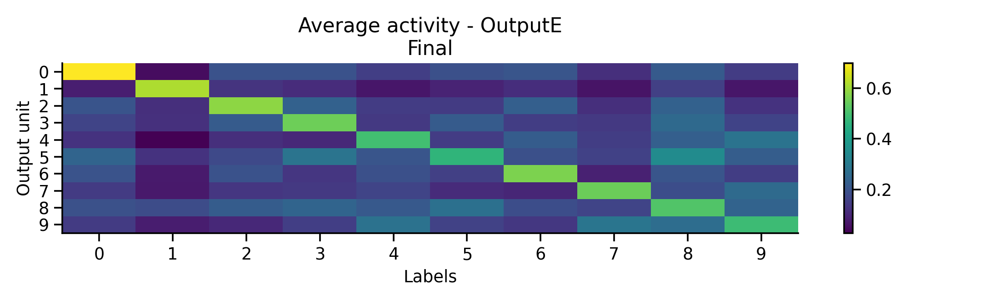

<IPython.core.display.Javascript object>


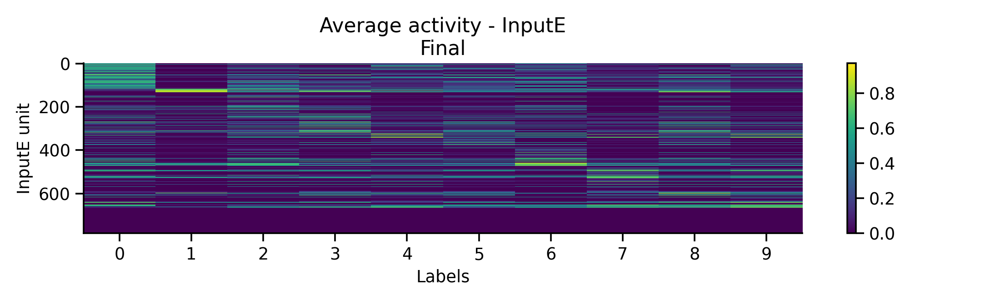

<IPython.core.display.Javascript object>


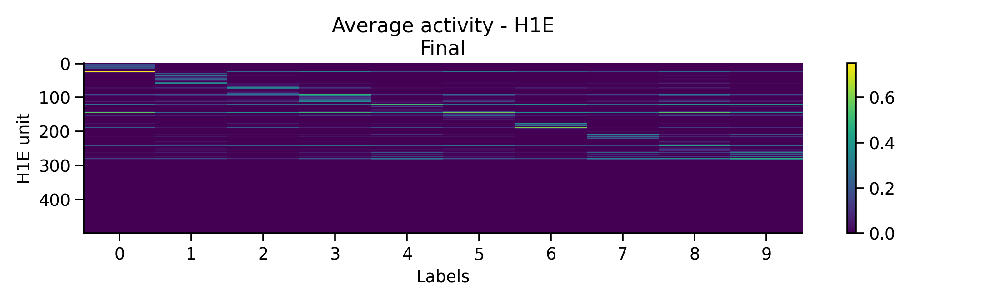

<IPython.core.display.Javascript object>


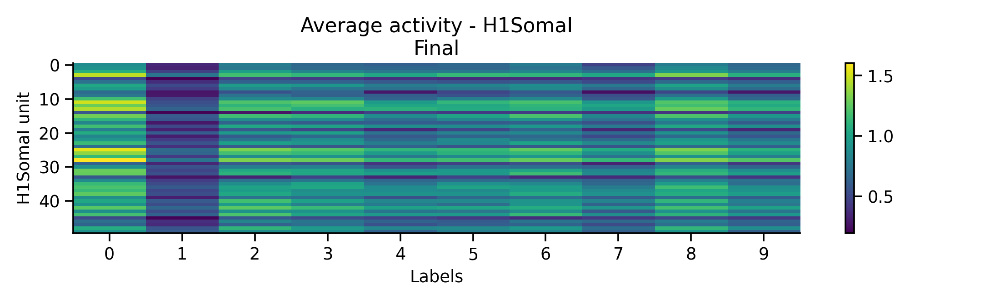

<IPython.core.display.Javascript object>


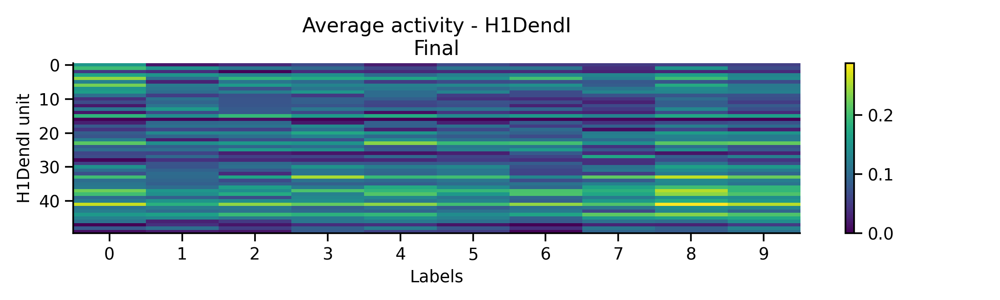

<IPython.core.display.Javascript object>


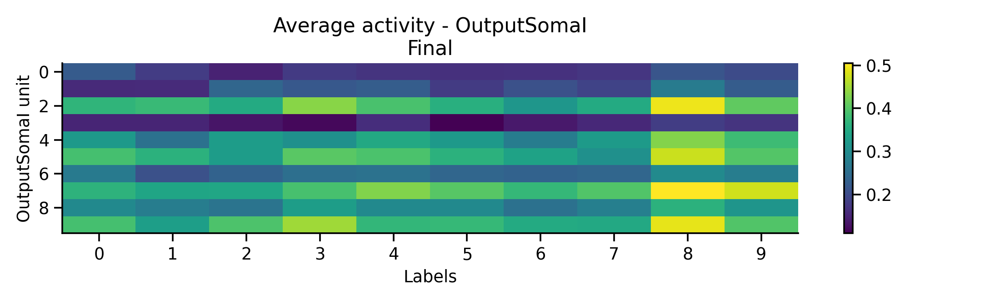

<IPython.core.display.Javascript object>


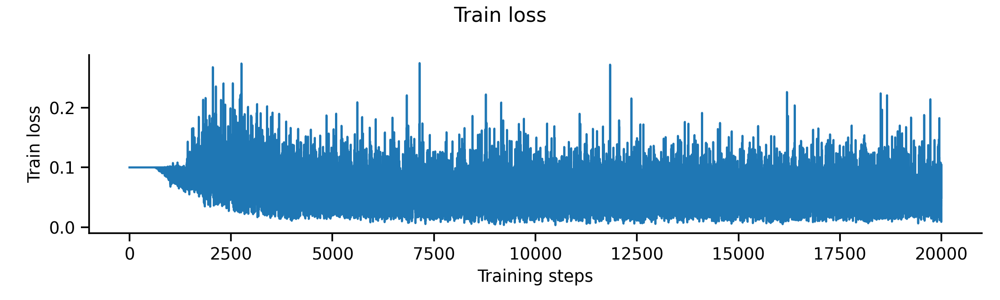

<IPython.core.display.Javascript object>


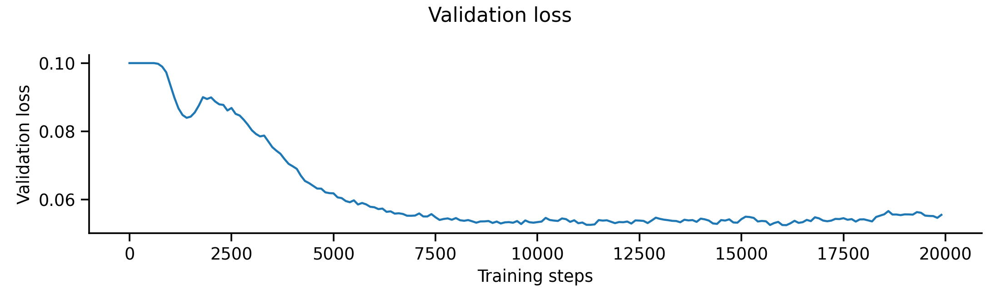

<IPython.core.display.Javascript object>


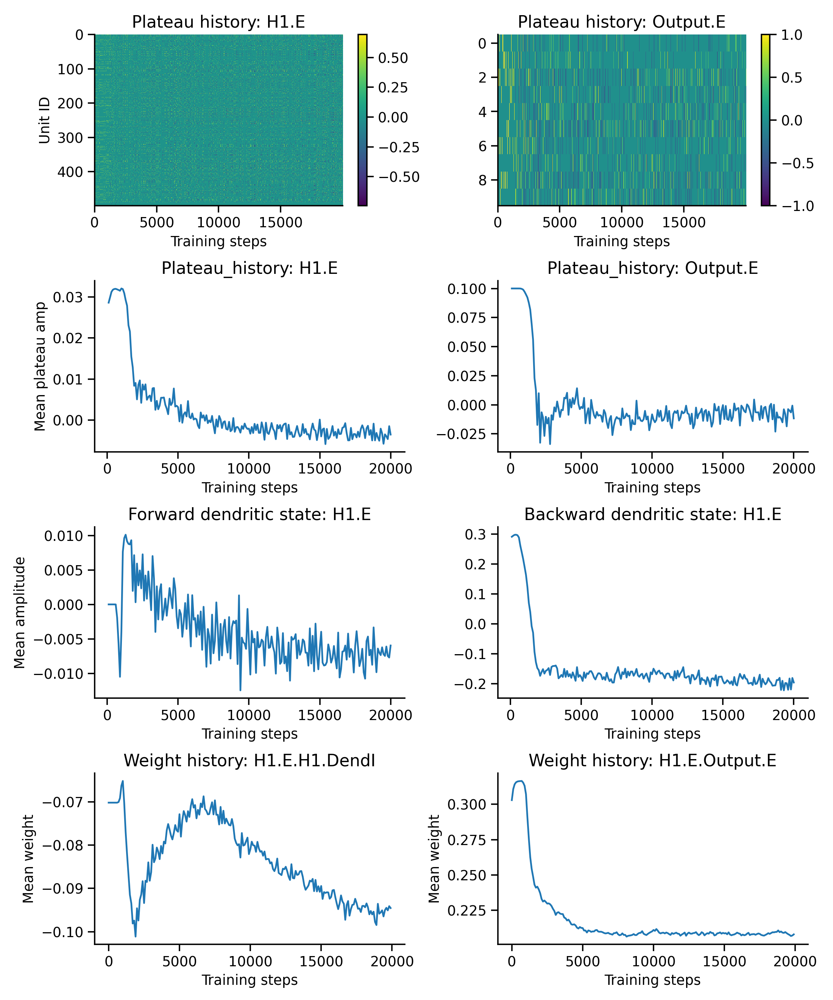

In [53]:
plot_mnist_network_accuracy(btsp_K1_network, test_dataloader, supervised=True)
plot_mnist_network_intermediates(btsp_K1_network)

## BTSP_F6

In [5]:
# Create network
network_config = ut.read_from_yaml('../optimize/data/mnist/20230720_EIANN_1_hidden_mnist_BTSP_config_F6_optimized.yaml')
layer_config = network_config['layer_config']
projection_config = network_config['projection_config']
training_kwargs = network_config['training_kwargs']

btsp_network_F6 = Network(layer_config, projection_config, seed=network_seed, **training_kwargs)

Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Samples:   0%|          | 0/20000 [00:00<?, ?it/s]

Batch accuracy = 87.91999816894531%


<IPython.core.display.Javascript object>


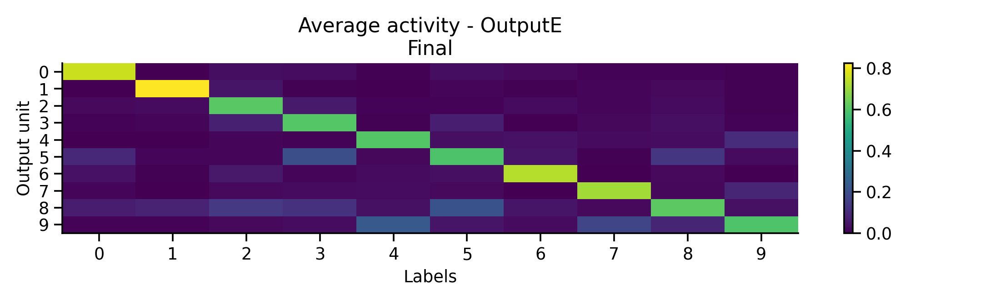

<IPython.core.display.Javascript object>


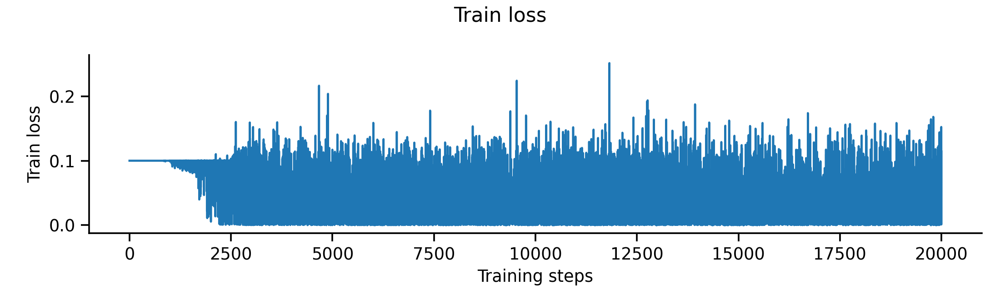

<IPython.core.display.Javascript object>


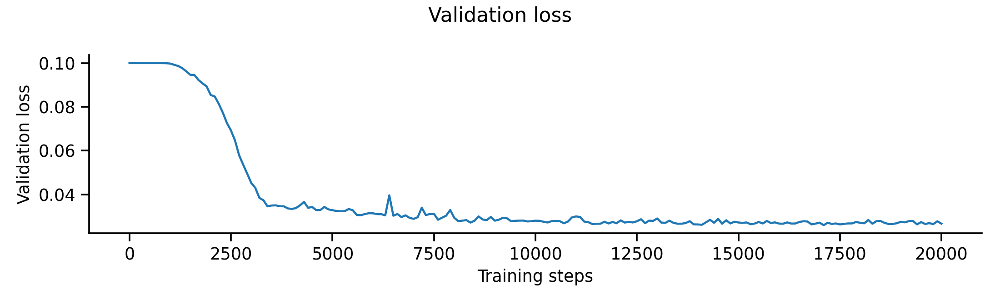

<IPython.core.display.Javascript object>


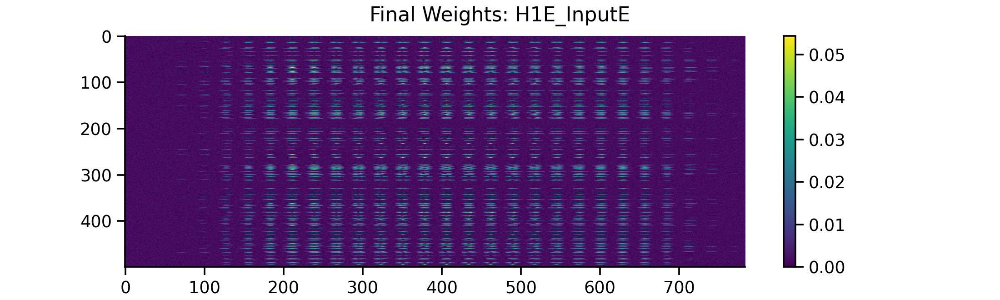

<IPython.core.display.Javascript object>


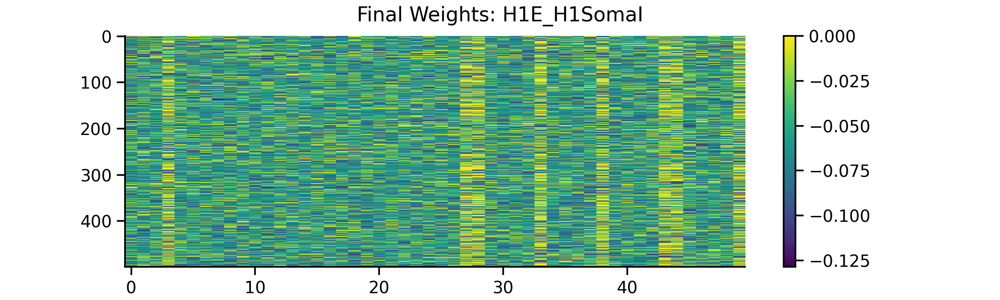

<IPython.core.display.Javascript object>


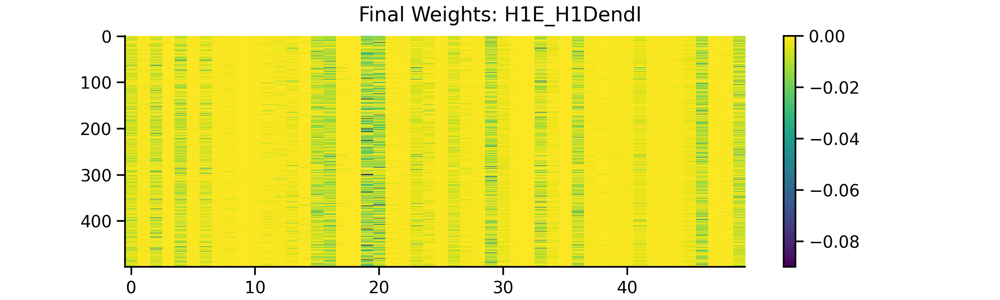

<IPython.core.display.Javascript object>


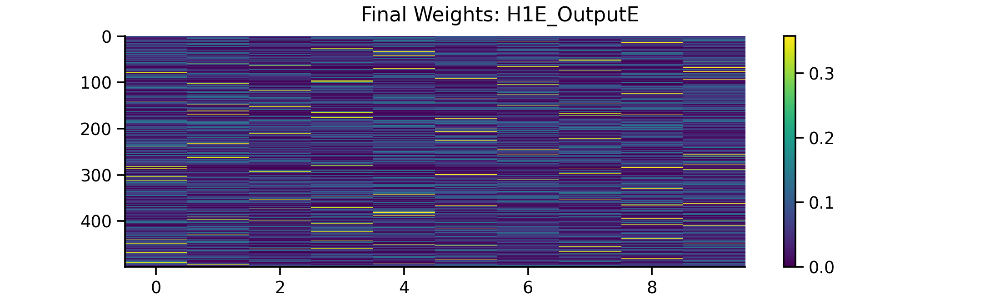

<IPython.core.display.Javascript object>


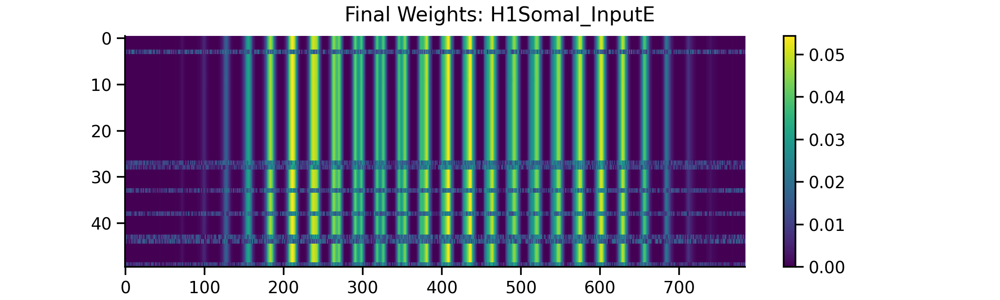

<IPython.core.display.Javascript object>


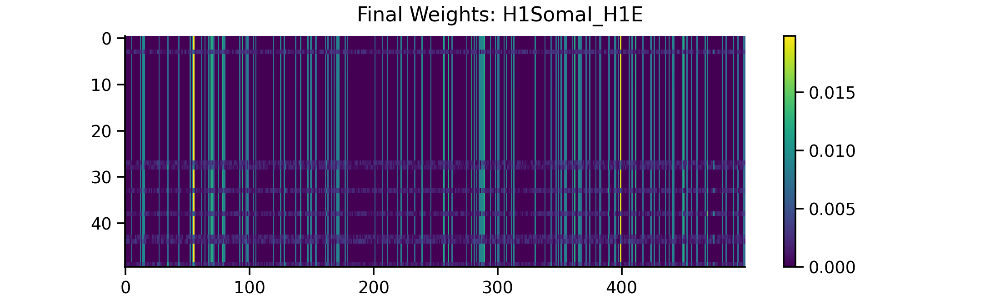

<IPython.core.display.Javascript object>


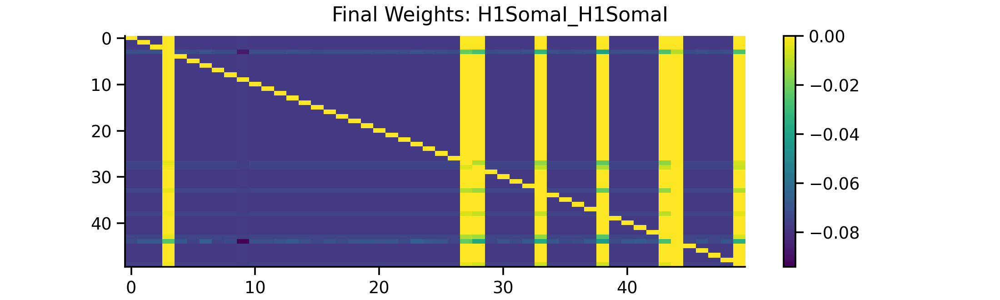

<IPython.core.display.Javascript object>


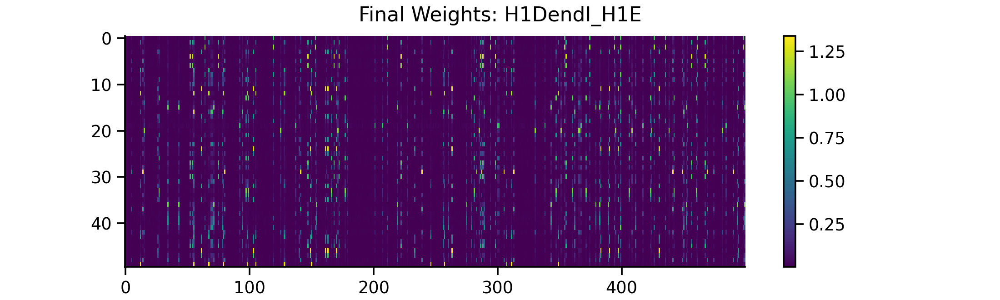

<IPython.core.display.Javascript object>


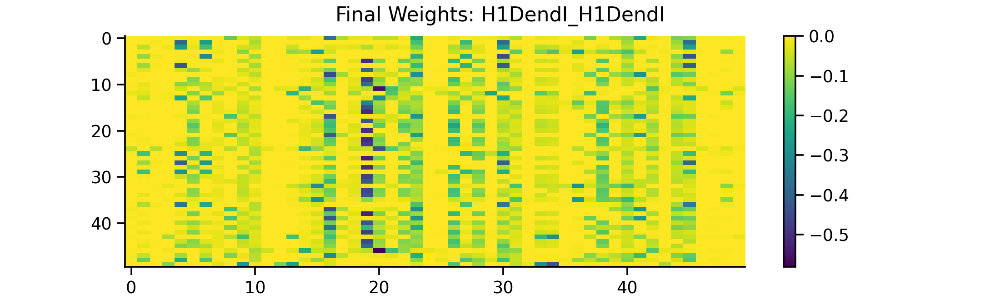

<IPython.core.display.Javascript object>


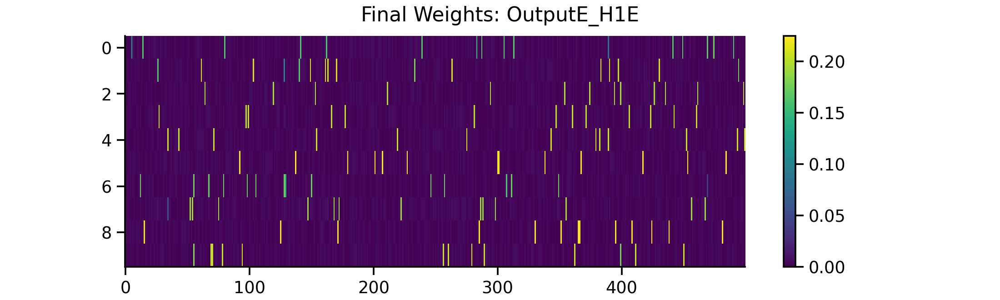

<IPython.core.display.Javascript object>


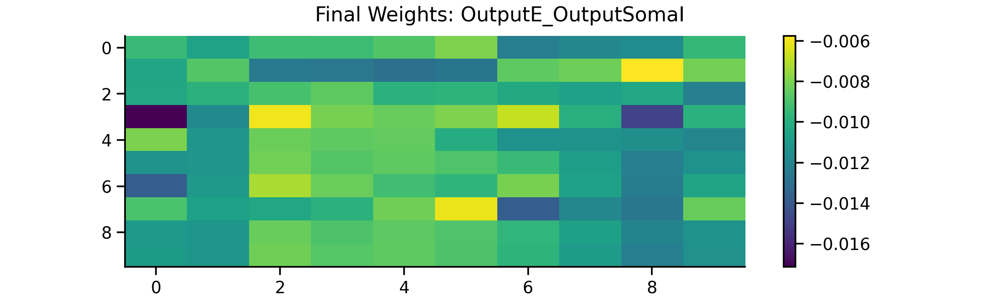

<IPython.core.display.Javascript object>


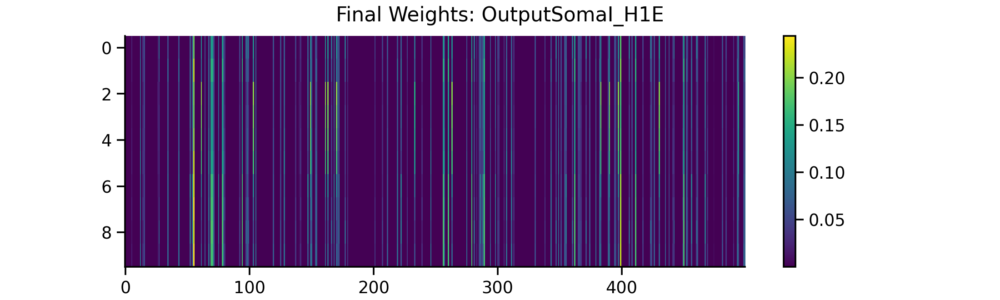

<IPython.core.display.Javascript object>


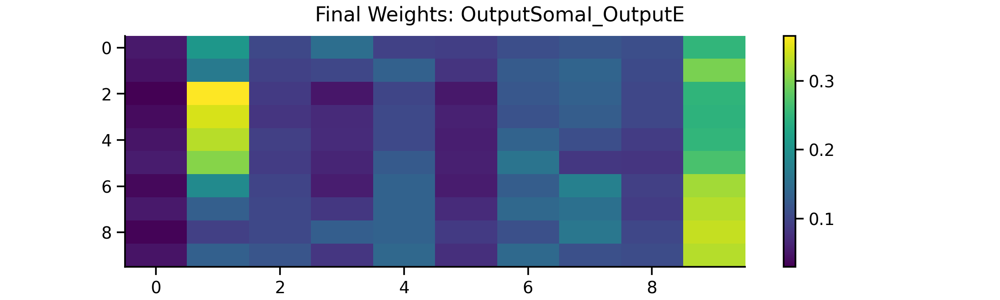

<IPython.core.display.Javascript object>


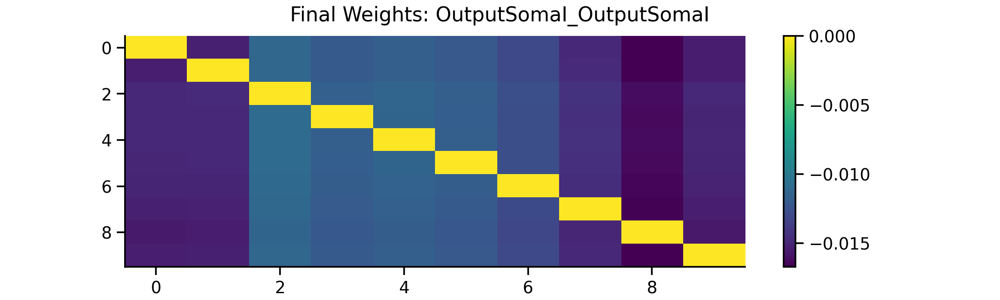

<IPython.core.display.Javascript object>


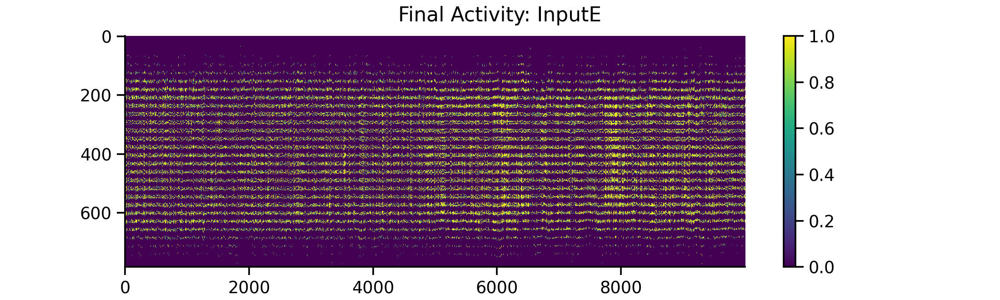

<IPython.core.display.Javascript object>


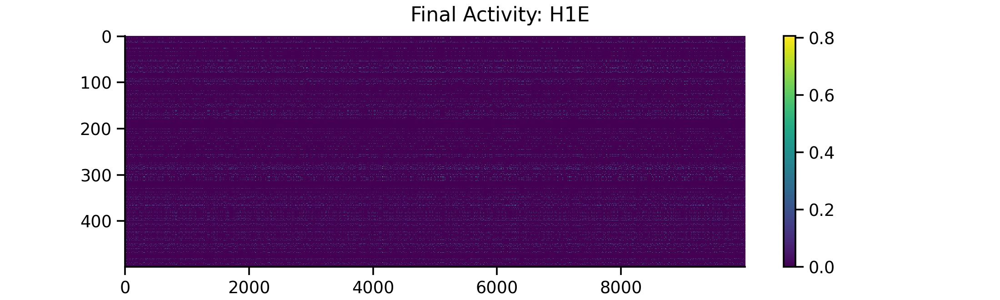

<IPython.core.display.Javascript object>


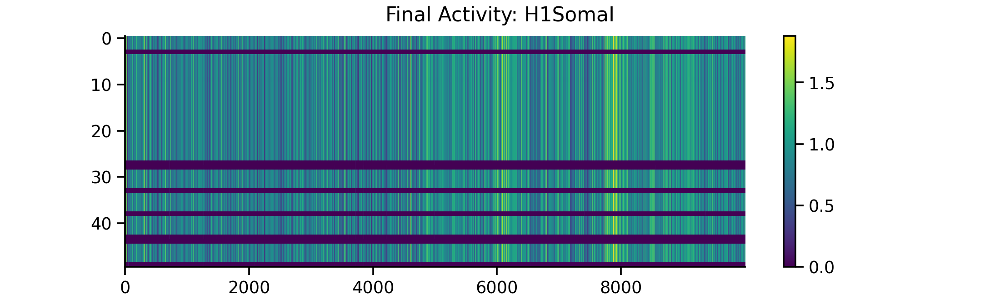

/var/folders/1v/63_09y215ml8k3bkh1my_dfw0000gn/T/ipykernel_19128/2199023725.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


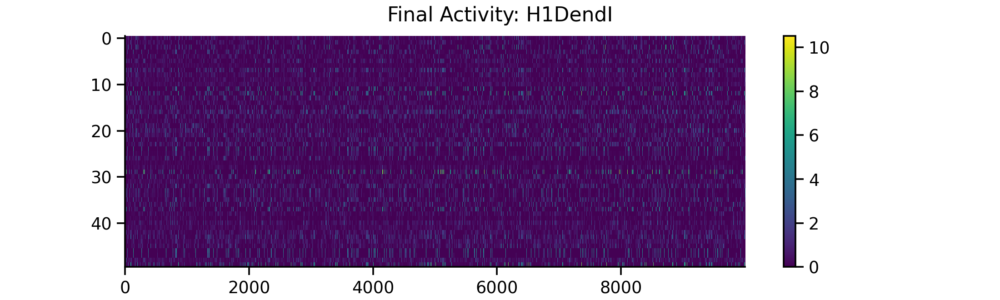

<IPython.core.display.Javascript object>


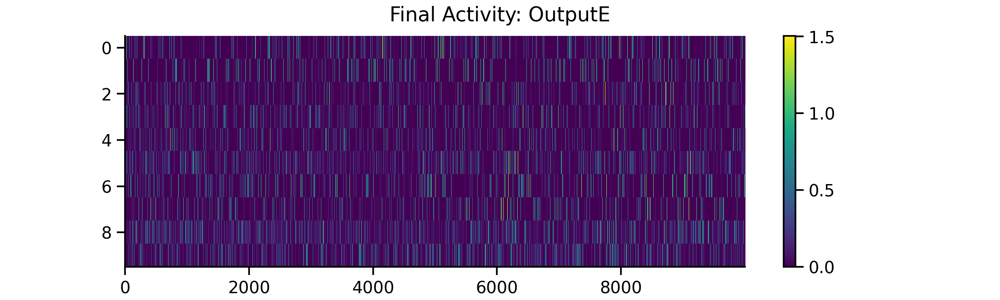

<IPython.core.display.Javascript object>


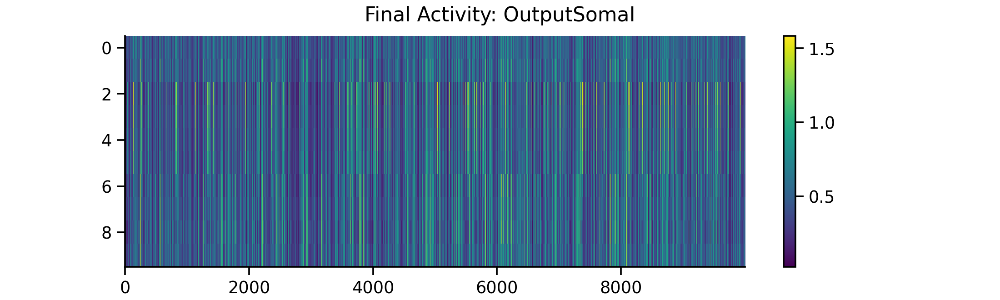

In [6]:
data_generator.manual_seed(data_seed)
# diagnose_mnist_network(btsp_network_F6, test_dataloader, full_train_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)
diagnose_mnist_network(btsp_network_F6, test_dataloader, train_sub_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)
# diagnose_mnist_network(btsp_network_F6, test_dataloader, debug_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)

<IPython.core.display.Javascript object>


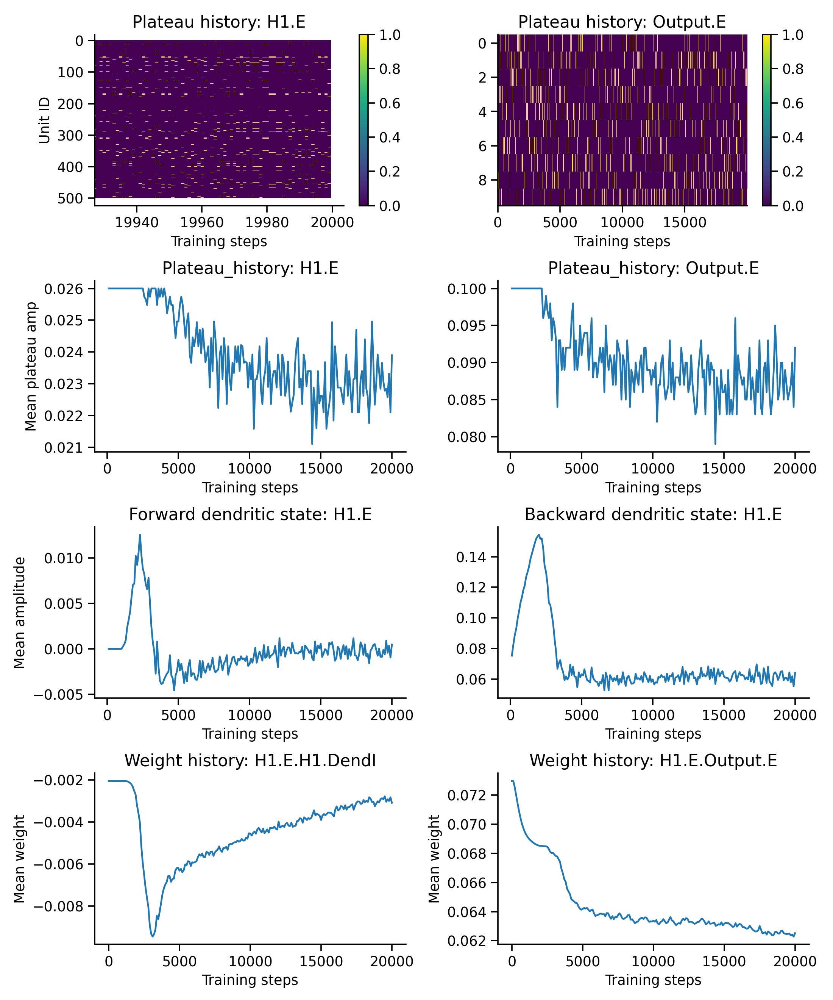

In [7]:
analyze_BTSP_intermediates(btsp_network_F6)

# BTSP_G3

In [5]:
# Create network
network_config = ut.read_from_yaml('../optimize/data/mnist/20230825_EIANN_1_hidden_mnist_BTSP_config_G3_optimized.yaml')
layer_config = network_config['layer_config']
projection_config = network_config['projection_config']
training_kwargs = network_config['training_kwargs']

btsp_network_G3 = Network(layer_config, projection_config, seed=network_seed, **training_kwargs)

Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Samples:   0%|          | 0/20000 [00:00<?, ?it/s]

Batch accuracy = 85.29000091552734%


<IPython.core.display.Javascript object>


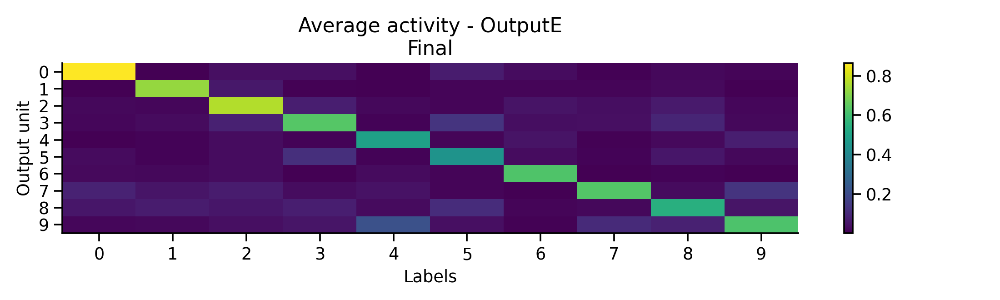

<IPython.core.display.Javascript object>


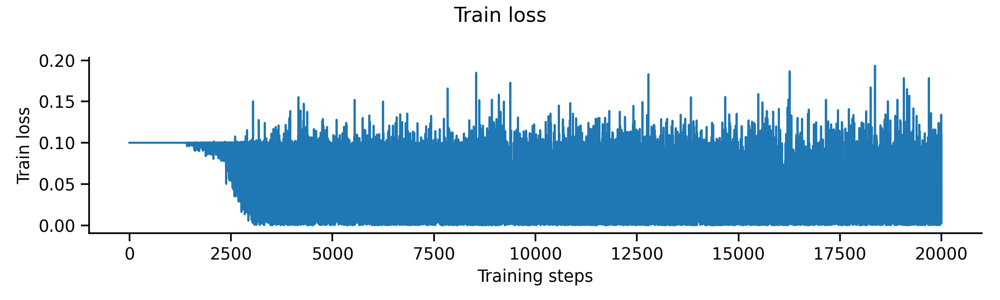

<IPython.core.display.Javascript object>


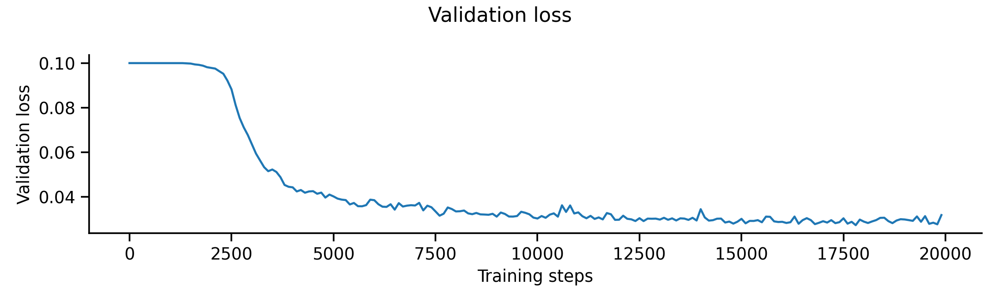

<IPython.core.display.Javascript object>


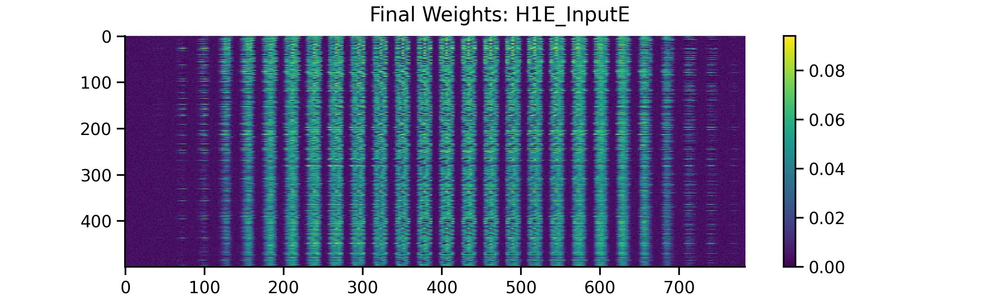

<IPython.core.display.Javascript object>


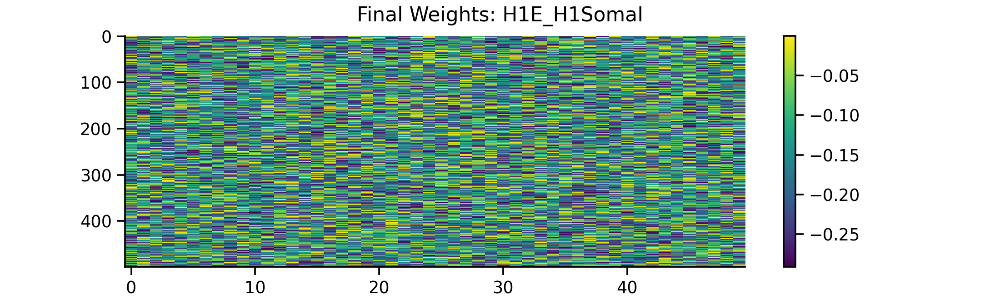

<IPython.core.display.Javascript object>


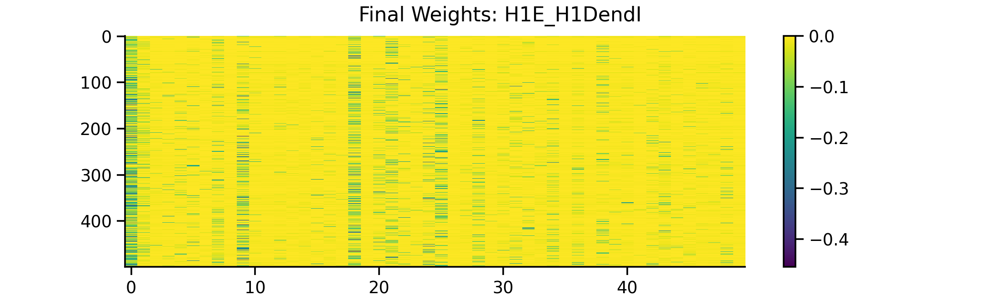

<IPython.core.display.Javascript object>


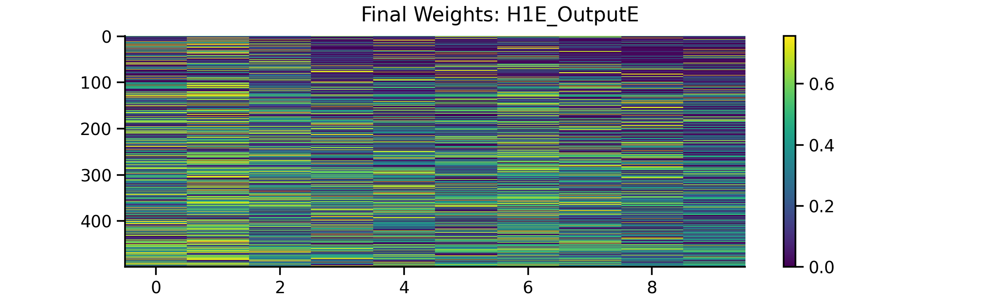

<IPython.core.display.Javascript object>


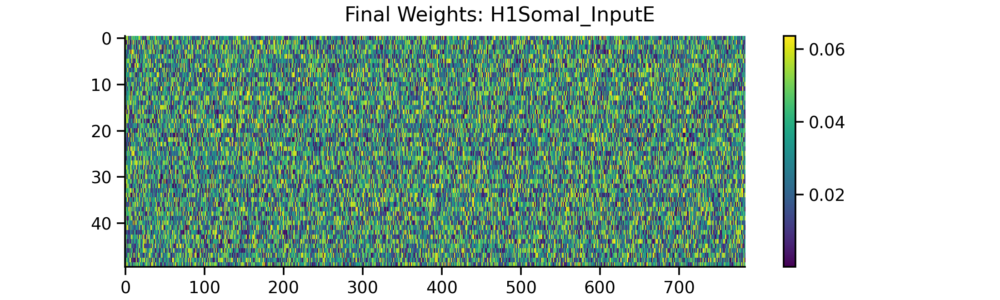

<IPython.core.display.Javascript object>


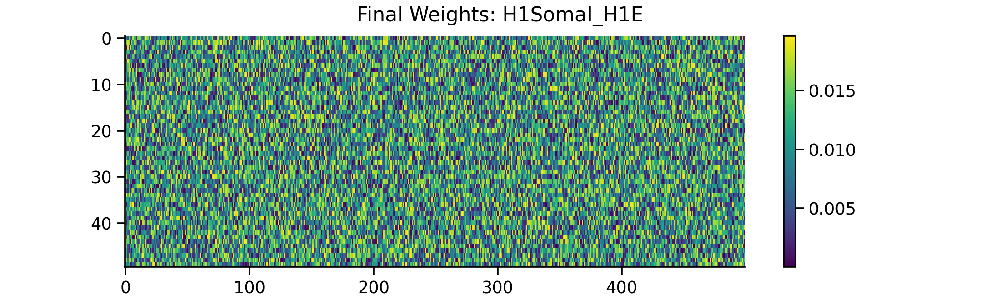

<IPython.core.display.Javascript object>


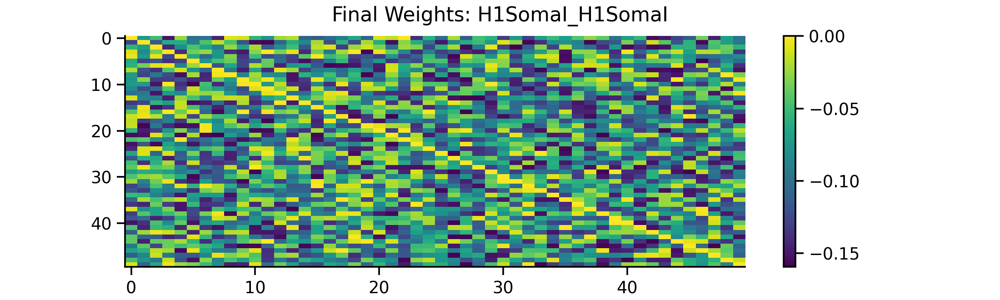

<IPython.core.display.Javascript object>


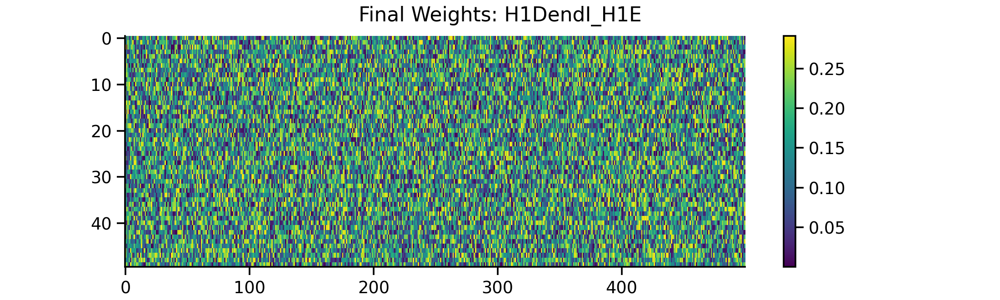

<IPython.core.display.Javascript object>


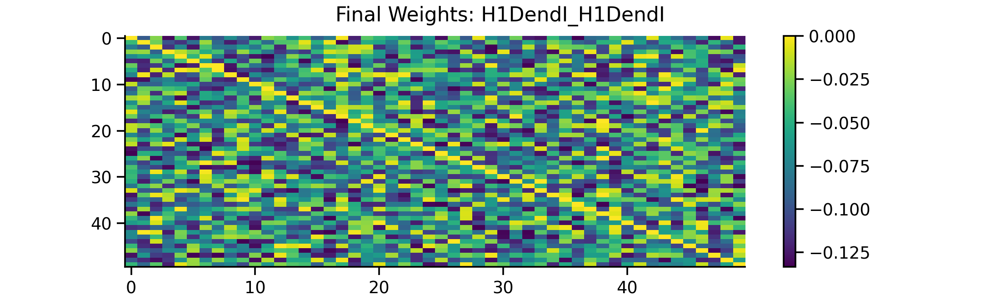

<IPython.core.display.Javascript object>


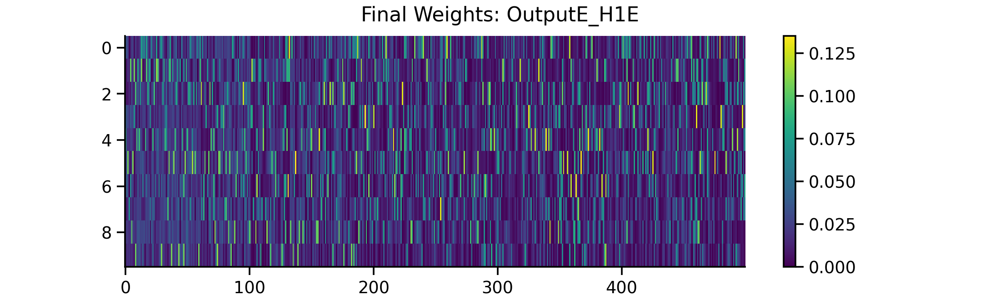

<IPython.core.display.Javascript object>


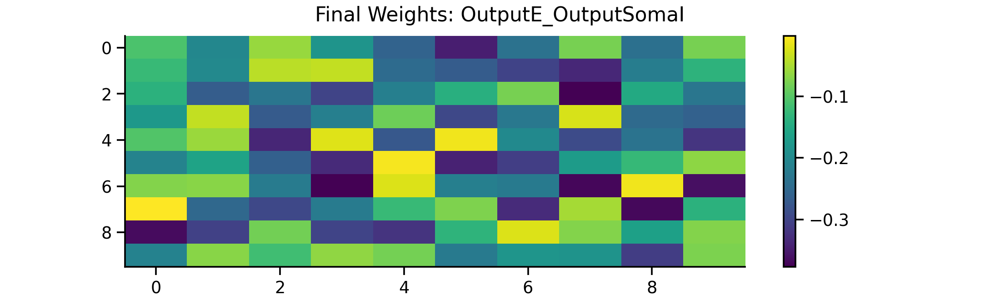

<IPython.core.display.Javascript object>


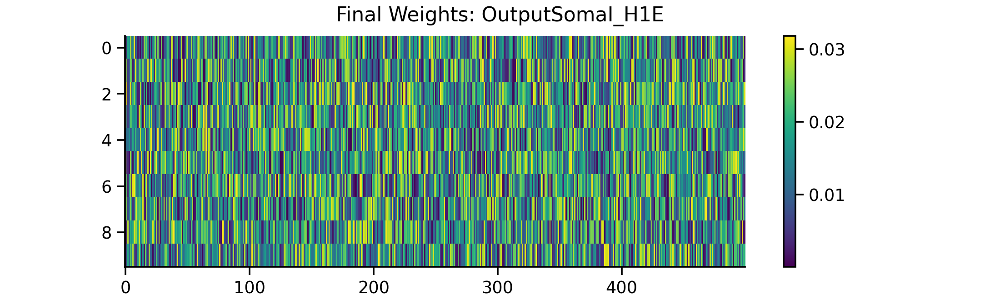

<IPython.core.display.Javascript object>


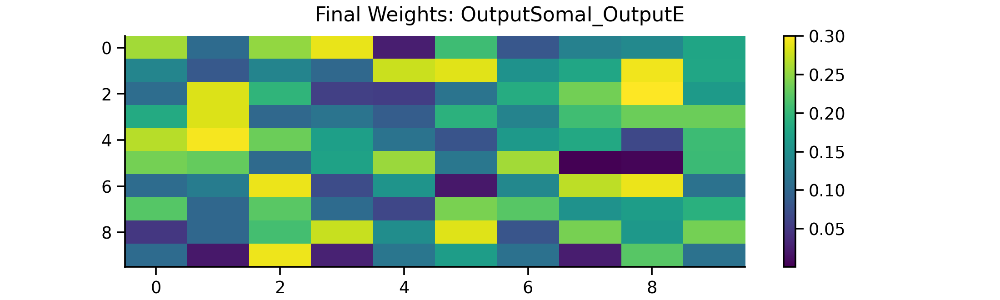

<IPython.core.display.Javascript object>


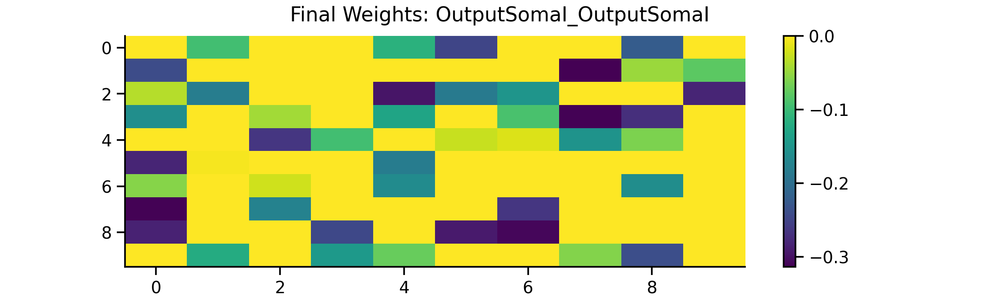

<IPython.core.display.Javascript object>


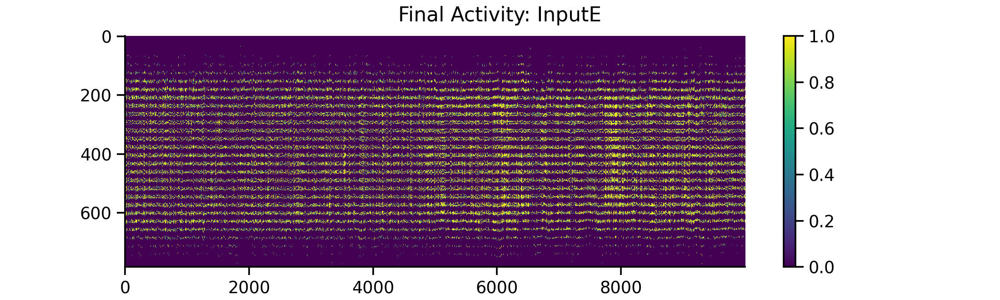

<IPython.core.display.Javascript object>


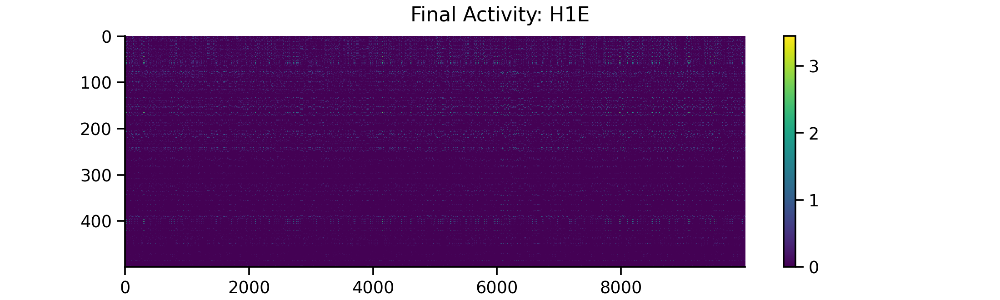

<IPython.core.display.Javascript object>


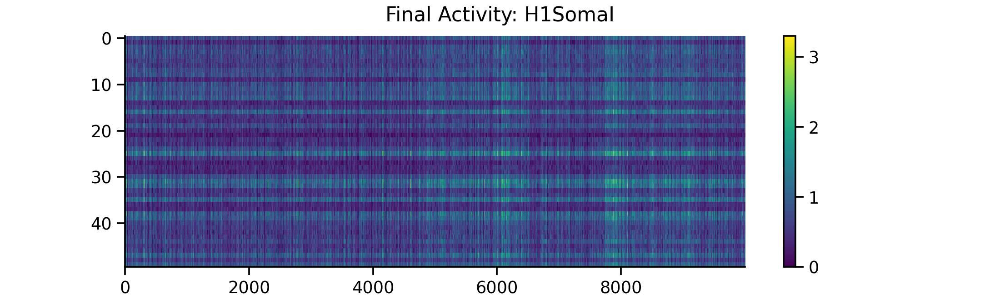

/var/folders/1v/63_09y215ml8k3bkh1my_dfw0000gn/T/ipykernel_4708/2199023725.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


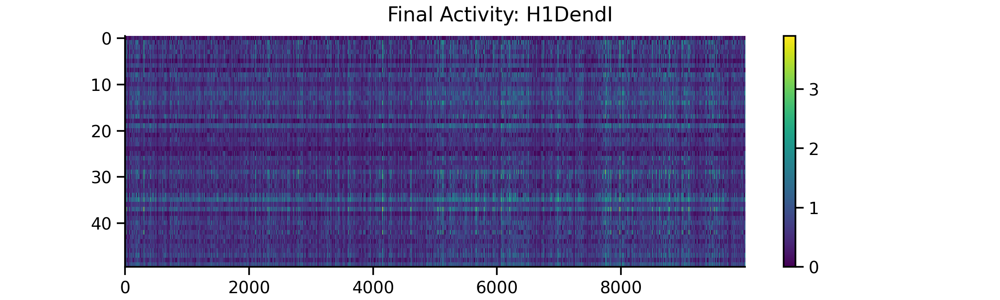

<IPython.core.display.Javascript object>


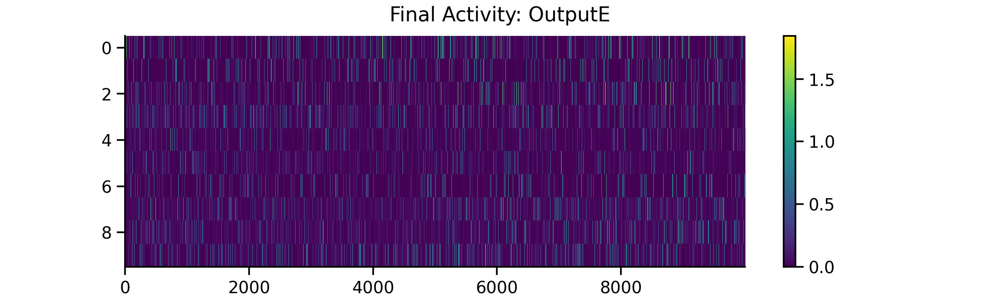

<IPython.core.display.Javascript object>


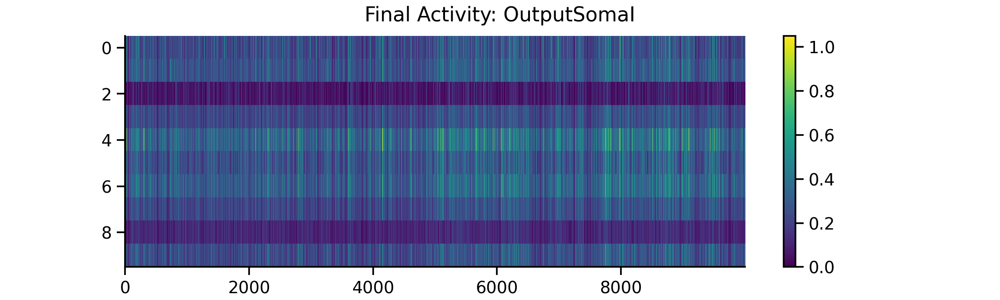

In [6]:
data_generator.manual_seed(data_seed)
# diagnose_mnist_network(btsp_network_G3, test_dataloader, full_train_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)
diagnose_mnist_network(btsp_network_G3, test_dataloader, train_sub_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)
# diagnose_mnist_network(btsp_network_G3, test_dataloader, debug_dataloader, val_dataloader, supervised=True, store_history=True, store_params=True)

<IPython.core.display.Javascript object>


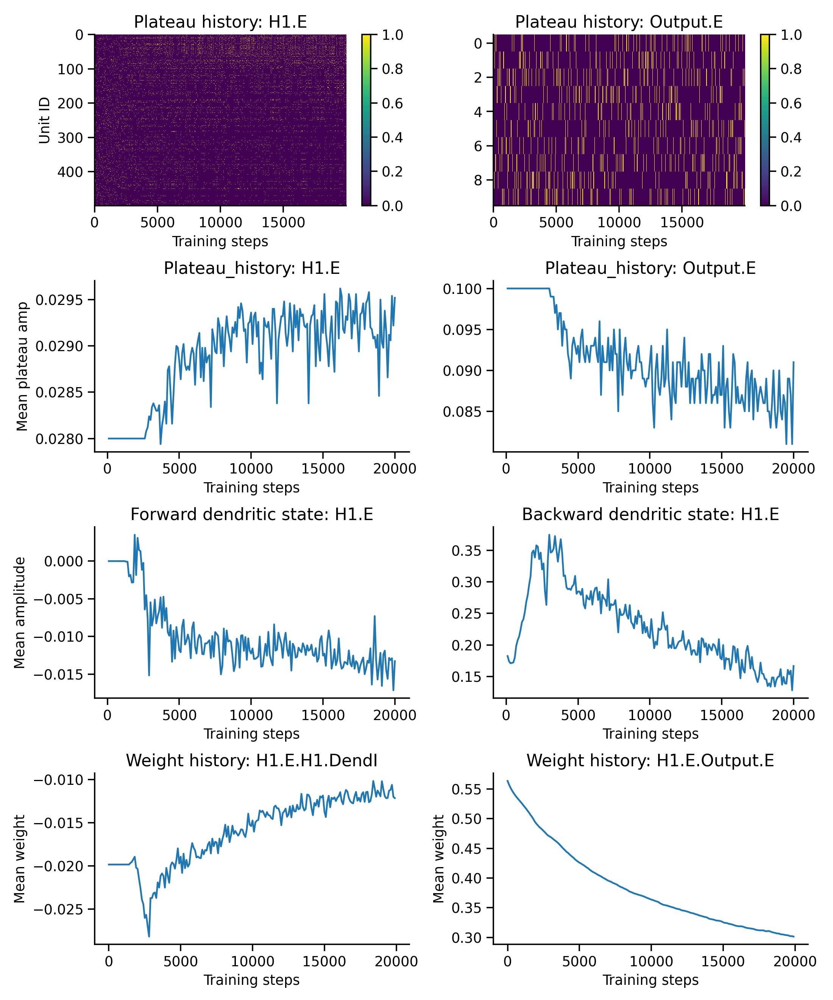

In [7]:
analyze_BTSP_intermediates(btsp_network_G3)